In [4]:
exec(open('imports.py').read())
from tqdm import tqdm
import matplotlib.ticker as mtk
import cf_xarray
%config InlineBackend.figure_format = 'retina'
import colormaps as cmaps 
convert = lambda x: chr(ord('`')+(x+1)) if x<26 else chr(ord('`')+((x)//25))+chr(ord('`')+(x+1)%26)

ERROR 1: PROJ: proj_create_from_database: Open of /global/homes/k/kquagra/miniconda3/envs/climate_py311.5/share/proj failed


## Preprocess data and save

In [1]:
import dask 
import dask.delayed

In [2]:
import dask 
import dask.delayed
# Define a function to normalize each variable in the dataset
@dask.delayed
def normalize_variable(var, var_type):
    ''' 
    This function normalises an xarray dataset for values between -1 and 1. 
    
    Arguments
    --------------
    
    var : xarray dataset or data array
    
    Return
    ----------
    
    xarray normalised dataset
    
    '''
    if var_type == 'levels':
        
        min_val = var.min(dim=['longitude','latitude'])    #obtain min value
        #print(min_val.values)
        max_val = var.max(dim=['longitude','latitude'])   # obtain max value
    elif var_type == 'surface':
        min_val = var.min()    #obtain min value  dim=['longitude','laitude']
        #print(min_val.values)
        max_val = var.max()   # obtain max value
        
    normalized_var = 2 * (var - min_val) / (max_val - min_val) - 1    #compute normalisation
    
    return normalized_var

In [5]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#variables =['epv','h','omega','slp','tqv','ivt']
variables = ['precipitationCal']
len_of_data = []
mpath='./MERRA2/'
for alx, alg in enumerate(algorithms):
    locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        #ds = [open_dataset(pt).compute() for pt in tqdm(pths,desc='Processing')]
        
        #ds = xr.concat(ds,dim='time')
        %time ds = xr.open_mfdataset(pths, chunks='auto')
        print(f'Done loading {vb} data \nCalculating mean')
        %time dds = ds.mean('time').load() 
        eval(f'{alg}_merra')[vb] = dds #xr.open_mfdataset(pths, chunks='auto')
        
        if vx <3:
            typ = 'surface'
        elif vx>=3:
            typ = 'surface'
            print('Calculating normalisations')
        eval(f'{alg}_merra')[vb][f'norm_{vb.upper()}'] = normalize_variable(dds,var_type=typ).compute()[vb.upper()]
        print(len(pths))
        sv_path = f'{mpath}Averages/'
        final_path = f'{sv_path}{alg}/'

        if os.path.isdir(sv_path) == False:
            os.mkdir(sv_path)

        if os.path.isdir(final_path) == False:
            os.mkdir(final_path)

        
        eval(f'{alg}_merra')[vb].to_netcdf(f'{final_path}{alg}_{vb}.nc')
        
    if vx == 0 :
        len_of_data.append(len(ds.time.values))


CASCADE_BARD_V1
CPU times: user 141 ms, sys: 72 ms, total: 213 ms
Wall time: 226 ms
Done loading precipitationCal data 
Calculating mean
CPU times: user 143 ms, sys: 235 ms, total: 378 ms
Wall time: 180 ms
16
SCAFET
CPU times: user 122 ms, sys: 114 ms, total: 236 ms
Wall time: 305 ms
Done loading precipitationCal data 
Calculating mean
CPU times: user 973 ms, sys: 3.15 s, total: 4.13 s
Wall time: 2.49 s
16
MUNDHENK_V3
CPU times: user 113 ms, sys: 126 ms, total: 239 ms
Wall time: 314 ms
Done loading precipitationCal data 
Calculating mean
CPU times: user 319 ms, sys: 1.55 s, total: 1.87 s
Wall time: 1.29 s
16
LORA_V2
CPU times: user 139 ms, sys: 93.7 ms, total: 233 ms
Wall time: 292 ms
Done loading precipitationCal data 
Calculating mean
CPU times: user 316 ms, sys: 1.35 s, total: 1.66 s
Wall time: 1.08 s
16
REID250
CPU times: user 101 ms, sys: 91.3 ms, total: 192 ms
Wall time: 288 ms
Done loading precipitationCal data 
Calculating mean
CPU times: user 384 ms, sys: 1.54 s, total: 1.92 s

In [7]:
#SAVE THE AVERAGE DATASETS FOR EASY FUTURE USE
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['precipitationCal']# ['epv','h','omega','slp','ivt']
for alx, alg in enumerate(algorithms):
    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    sv_path = f'Averages/'
    final_path = f'{sv_path}{alg}/'
    
    if os.path.isdir(sv_path) == False:
        os.mkdir(sv_path)
    
    if os.path.isdir(final_path) == False:
        os.mkdir(final_path)
        
    for vx,vb in enumerate(variables):
                
        eval(f'{alg}_merra')[vb].to_netcdf(f'{final_path}{alg}_{vb}.nc')

CASCADE_BARD_V1
SCAFET
MUNDHENK_V3
LORA_V2
REID250
CONNECT500
GERSHUNOV
GUAN_WALISER


## LOAD DATA AND START PLOTTING 

In [5]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['h','omega','slp','tqv','ivt','precipitationCal']
#variables = ['ivt']
len_of_data = []
mpath='./MERRA2/'
for alx, alg in enumerate(algorithms):
    locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        #ds = [open_dataset(pt).compute() for pt in tqdm(pths,desc='Processing')]
        
        #ds = xr.concat(ds,dim='time')
        ds = xr.open_mfdataset(pths, chunks='auto')
    if vx == 0 :
        len_of_data.append(len(ds.time.values))
        

CASCADE_BARD_V1
SCAFET
MUNDHENK_V3
LORA_V2
REID250
CONNECT500
GERSHUNOV
GUAN_WALISER
CPU times: user 15.6 s, sys: 14.6 s, total: 30.2 s
Wall time: 37.1 s


In [6]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['epv','h','omega','slp','tqv','ivt','precipitationCal']

for alx,alg in enumerate(algorithms):
    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}Averages/{alg}/*{vb}*', recursive=True)

        if vb == 'tqv' or vb=='precipitationCal':
                ds = xr.open_mfdataset(pths).sel(longitude=slice(-24,24),latitude=slice(-14,14))
        else:
                ds = xr.open_mfdataset(pths).sel(lon=slice(-24,24),lat=slice(-14,14))
                
        eval(f'{alg}_merra')[f'{vb}'] = ds

CPU times: user 378 ms, sys: 233 ms, total: 611 ms
Wall time: 764 ms


In [7]:
from matplotlib.colors import CenteredNorm

## KMEANS 

In [8]:
exec(open('imports.py').read())
import tqdm
import matplotlib.ticker as mtk
from matplotlib.colors import LinearSegmentedColormap

In [9]:
levs_2_plot = [925,850,700,500,300,250]

In [10]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['epv','h','omega','slp','tqv','ivt']
groups = np.arange(0,2)
for alx,alg in enumerate(algorithms):
    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    
    for vx,vb in enumerate(variables):
        
        for gr in groups:
            pths = glob.glob(f'Averages/{alg}_cluster/*{gr}_{vb}*', recursive=True)
            
            if vb == 'tqv':
                ds = xr.open_mfdataset(pths).sel(longitude=slice(-24,24),latitude=slice(-14,14))
            else:
                ds = xr.open_mfdataset(pths).sel(lon=slice(-24,24),lat=slice(-14,14))
            eval(f'{alg}_merra')[f'{vb}_{gr}'] = ds

CPU times: user 491 ms, sys: 366 ms, total: 857 ms
Wall time: 1.29 s


In [ ]:

##################################################################################################
#                                                         Load data for Kmeans dataset and store them                                                             #
##################################################################################################

algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['h','epv','omega','ivt','slp','tqv']
len_of_data = []
mpath='./MERRA2/'
for alx, alg in enumerate(algorithms):
    locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        #ds = [xr.open_dataset(pt, chunks='auto') for pt in pths]
        #ds = xr.concat(ds,dim='time')
        ds = xr.open_mfdataset(pths, chunks='auto')
        print('Done loading data \nCalculating mean')
        
        with open(f'cluster_numbers/cluster_values_{alg}') as clusters:
            cluster = clusters.readlines()
            cluster = [int(x[0]) for x in cluster]
        print(len(cluster))
            
        ds['time'] = cluster
        
        print('Loading for groups')
        groups = ds.groupby('time').groups.keys()
        for gr in groups:
            if vx <=2:
                typ = 'levels'
                dds = ds.sel(lev=levs_2_plot, time=gr).mean('time').load()
            elif vx>=3:
                typ = 'surface'
                dds = ds.sel(time=gr).mean('time').load()
            
            #eval(f'{alg}_merra')[f'{vb}_c{gr}'] = dds   #.load()  #xr.open_mfdataset(pths, chunks='auto')
            sv_path = f'Averages/'
            
           
            print('Calculating normalisations')
            %time dds[f'norm_{vb.upper()}'] = normalize_variable(dds,var_type=typ).compute()[vb.upper()]
            
            sv_path='Averages/'
            final_path = f'{sv_path}{alg}_cluster/'

            if os.path.isdir(sv_path) == False:
                os.mkdir(sv_path)

            if os.path.isdir(final_path) == False:
                os.mkdir(final_path)
            
            dds.to_netcdf(f'{final_path}{alg}_cluster{gr}_{vb}.nc')
            
            
        #print(len(pths))
        
        #if vx == 0 :
            #len_of_data.append(len(ds.time.values))

CASCADE_BARD_V1
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
CPU times: user 4.25 ms, sys: 50 µs, total: 4.3 ms
Wall time: 4.18 ms
Calculating normalisations
CPU times: user 4.32 ms, sys: 65 µs, total: 4.39 ms
Wall time: 4.27 ms
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
CPU times: user 4.68 ms, sys: 139 µs, total: 4.82 ms
Wall time: 4.8 ms
Calculating normalisations
CPU times: user 4.44 ms, sys: 89 µs, total: 4.53 ms
Wall time: 4.53 ms
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
CPU times: user 4.35 ms, sys: 70 µs, total: 4.42 ms
Wall time: 4.27 ms
Calculating normalisations
CPU times: user 4.7 ms, sys: 141 µs, total: 4.84 ms
Wall time: 4.7 ms
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
CPU times: user 4.09 ms, sys: 17 µs, total: 4.11 ms
Wall time: 4.09 ms
Calculating normalisations
CPU times: user 4.32 ms, sys: 64 

In [11]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
#variables = ['h',]#'slp',
variables=['precipitationCal']
len_of_data = []
mpath='./MERRA2/'
for alx, alg in enumerate(algorithms):
    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        #ds = [xr.open_dataset(pt, chunks='auto') for pt in pths]
        #ds = xr.concat(ds,dim='time')
        ds = xr.open_mfdataset(pths, chunks='auto')
        print('Done loading data \nCalculating mean')
        #dds = ds.mean('time')
        
        #Do this because GW had a larger data size, so I did the clustering in smaller chunks and had 4 different files for the cluster.
        #if alg != 'guan_waliser':
        with open(f'cluster_numbers/cluster_values_{alg}') as clusters:
            cluster = clusters.readlines()
            cluster = [int(x[0]) for x in cluster]
        print(len(cluster))
            
        if vb == 'precipitationCal':
            st_point = len(cluster)-len(ds['time'])
            ds['time'] = cluster[st_point:]
        else:
            ds['time'] = cluster
        
        print('Loading for groups')
        groups = ds.groupby('time').groups.keys()
        for gr in groups:
            if vb == 'precipitationCal':
                eval(f'{alg}_merra')[f'{vb}_{gr}'] = ds.sel(time=gr).mean('time').load()
            else:
                eval(f'{alg}_merra')[f'{vb}_{gr}'] = ds.sel(time=gr).mean('time')#.load()#.load()  #xr.open_mfdataset(pths, chunks='auto')
        print(len(pths))
        
        if vx == 0 :
            len_of_data.append(len(ds.time.values))

CASCADE_BARD_V1
Done loading data 
Calculating mean
6524
Loading for groups
16
SCAFET
Done loading data 
Calculating mean
26310
Loading for groups
16
MUNDHENK_V3
Done loading data 
Calculating mean
16601
Loading for groups
16
LORA_V2
Done loading data 
Calculating mean
13783
Loading for groups
16
REID250
Done loading data 
Calculating mean
16557
Loading for groups
16
CONNECT500
Done loading data 
Calculating mean
3121
Loading for groups
16
GERSHUNOV
Done loading data 
Calculating mean
18043
Loading for groups
16
GUAN_WALISER
Done loading data 
Calculating mean
78522
Loading for groups
16


In [12]:
def count_elements_with_number(lst, target):
    return len([element for element in lst if element == target])

cluster_lengths = []

cluster_len = []
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
for alx, alg in enumerate(algorithms):
   
    with open(f'cluster_numbers/cluster_values_{alg}') as clusters:
        cluster = clusters.readlines()
        cluster = [int(x[0]) for x in cluster]

        CLS=[]
        for x_ in np.arange(1,3):
            res = count_elements_with_number(cluster,x_-1)
            CLS.append([x_-1 ,res])

        #for x_ in np.arange(1,5):
        eval(f'cluster_len').append(sorted(CLS, key=lambda x: x[1], reverse=True))
        print(len(cluster))
    cluster_lengths.append(len(cluster))

6524
26310
16601
13783
16557
3121
18043
78522


In [13]:
kk = np.array(cluster_len)

In [14]:
cluster1_len = kk[:,0]
cluster2_len = kk[:,1]
#cluster3_len = kk[:,2]
#cluster4_len = kk[:,3]

## PGF FORCE AND WAVE STATISTICS

In [15]:
import math
def calc_pgf(data, lon_name = 'lon',lat_name='lat'):
    
    """
    This takes in a data array and computes the pressure gradient force in Pa/degrees lonlat.
    
    Argument:
    data : an xarray data array
    lon_name: name for longitude in dataset 
    lat_name : name for latitude in dataset 
    
    Return
    ---------
    
    PD : difference in pressure
    D : Distance from high pressure and low pressure centers
    PGF: Pressure gradient force
    angle: Angle subtended from the low pressure to the high pressure 
    """
    A = [data.argmin(dim=[lon_name,lat_name])[lon_name].values, data.argmin(dim=[lon_name,lat_name])[lat_name].values]   #obtain low pressure data point
    B = [data.argmax(dim=[lon_name,lat_name])[lon_name].values, data.argmax(dim=[lon_name,lat_name])[lat_name].values]  #obtain high pressure data point
    
    _text_data_A = data.isel(lon=A[0],lat=A[1])    
    _text_data_B = data.isel(lon=B[0],lat=B[1])    
    
    #print(_text_data_A)
    Ax,Ay =_text_data_A.lon.values, _text_data_A.lat.values    #obtain the exact lon, lats for the lows 
    Bx,By =_text_data_B.lon.values, _text_data_B.lat.values    #obtain the exact lon, lats for the highs 
    
    Cx, Cy = Ax, By
    
    PD = _text_data_B - _text_data_A
    #print(PD.values)
    #calculate hypotenuse 
    D = math.sqrt((Bx - Ax)**2 + (By - Ay)**2)           #meters 
    
    adjacent = math.sqrt((Cx-Ax)**2 + (Cy - Ay)**2)       # meters 
    #print(D)
    PGF = PD/D
    
    angle = math.degrees(math.acos(adjacent/D))
    
    return  PGF.values, PD, D, angle, (Ax,Ay), (Bx,By), (Cx,Cy)


def closest_num(list1,target):
    '''Obtain the closest number in list to a target number'''
    return min(list1 , key=lambda x: abs(x-target))

In [16]:
import seaborn as sb

### EOF ANALYSIS

In [17]:
def dot_size(vs1):
    dates = pd.date_range(start='1980',end='2017-12-31', freq='1H')
    len_dates = len(dates)
    #res =[((v1 * v2)/(m1*m2))*100  for v1,v2 in zip(vs1,vs2)]
    res = [(v1/len_dates)*1000 for v1 in vs1 ]
    return res

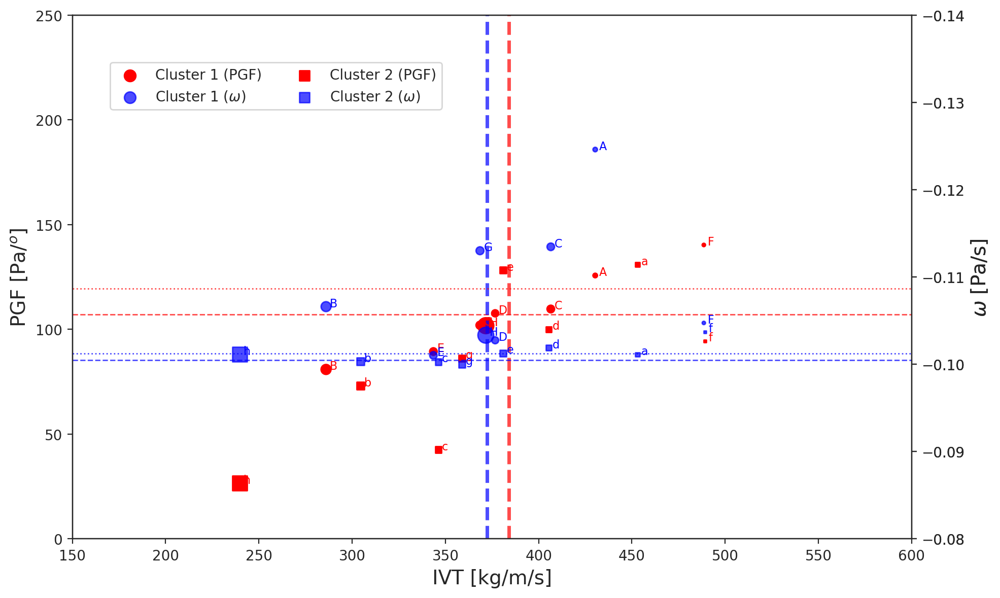

In [157]:
fig, ax = plt.subplots(figsize=(10, 6))
cols = ['red', 'blue']
markers = ['o', 's']       # Markers for main axis
markers2 = ['o', 's']      # Different markers for secondary axis
labels = ['Cluster 1', 'Cluster 2']


handles = []
legend_labels = []
sb.set_style('ticks')

# Loop through clusters and plot each on primary and secondary axes
for nx, col, mk, mk2, lbl in zip(range(2), cols, markers, markers2, labels):
    
    clust_vals =  eval(f'cluster{nx+1}_len')[:,1]
    i_data = eval(f'Clust_{nx}_ivt')
    j_data_surf = eval(f'Clust_{nx}_pgfs_surf')
    j_data_w = eval(f'Clust_{nx}_w')
    m0 = np.mean(i_data)
    m1 = np.mean(j_data_surf)
    m2= np.mean(j_data_w)

    # Scatter for surface data on primary axis
    #size = dot_size(i_data,j_data_surf,m0,m1)
    size = dot_size(clust_vals)
    scatter_main = ax.scatter(i_data, j_data_surf, color='red', marker=mk, s=size, label=f"{lbl} Surface")
    handles.append(scatter_main)
    legend_labels.append(f"{lbl} (PGF)")

    for i1, j1, inx in zip(i_data, j_data_surf, range(8)):
        if nx==0:
            ax.text(i1 + 2, j1, convert(inx).upper(), color='red', fontsize=8)
        else:
            ax.text(i1 + 2, j1, convert(inx), color='red', fontsize=8)

    # Vertical and horizontal lines for surface data means
    ax.axvline(m0, color=col, linestyle='--', linewidth=2.5, alpha=0.7)
    ax.axhline(m1, color=col, linestyle='--', linewidth=1., alpha=0.7)

    # Main axis settings
    ax.set_xlim(150, 600)
    ax.set_ylim(0, 250)
    ax.set_xlabel("IVT [kg/m/s]", fontsize=14)
    ax.set_ylabel("PGF [Pa/$^o$]", fontsize=14)
    #ax.set_title("Cluster Analysis of IVT and PGFS with Secondary Axis for W")

    # Secondary axis for vertical component 'w'
    ax2 = ax.twinx()
    #size = dot_size(i_data,j_data_w,m0,m2)
    size = dot_size(clust_vals)
    scatter_secondary = ax2.scatter(i_data, j_data_w, color='blue', marker=mk2, s=size, alpha=0.7, label=f"{lbl} ($\omega$)")
    handles.append(scatter_secondary)
    legend_labels.append(f"{lbl} ($\omega$)")

    for i1, j1, inx in zip(i_data, j_data_w, range(8)):
        
        if nx==0:
            ax2.text(i1 + 2, j1, convert(inx).upper(), color='blue', fontsize=8)
        else:
            ax2.text(i1 + 2, j1, convert(inx), color='blue', fontsize=8)
            
    # Horizontal line for vertical component 'w' mean
    ax2.axhline(m2, color=col, linestyle=':', linewidth=1, alpha=0.7)

    # Secondary axis settings
    ax2.set_ylim(-0.08, -0.14)
    ax2.set_ylabel("$\omega$ [Pa/s]", fontsize=14)

# Combined legend from handles and labels
fig.legend(handles,legend_labels, loc='upper right', ncols=2,bbox_to_anchor=(0.45, 0.90))

plt.tight_layout()
plt.savefig('Images/Scatter_plot_clusters_new.pdf', dpi=300)
#plt.show()

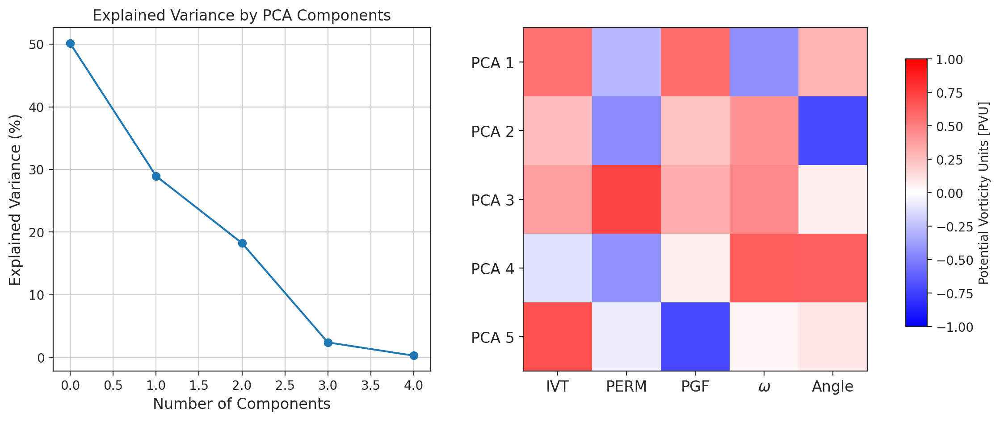

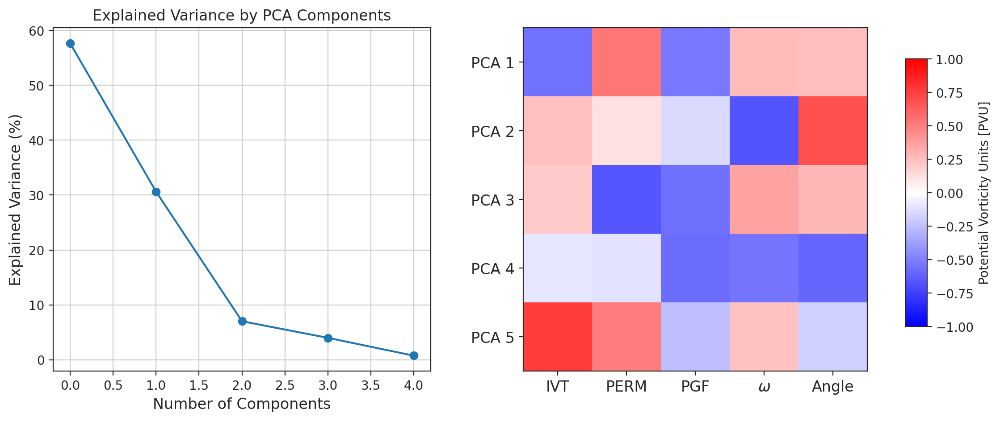

In [92]:
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

for nx in range(0,2):
    # Example data: four lists representing different variables over time
    list1 =  eval(f'Clust_{nx}_ivt')
    list2 = size
    list3 =  eval(f'Clust_{nx}_pgfs_surf')
    list4 =  eval(f'Clust_{nx}_w')
    list5 =  eval(f'Clust_{nx}_angle')
    #list5 = eval(f'Clust_{nx}_angle_500')
    # Step 1: Combine the lists into a single 2D array with shape (time, variables)
    data_matrix = np.column_stack([list1, list2, list3, list4,list5])

    # Step 2: Standardize the data (optional, but recommended for PCA)
    data_matrix -= np.mean(data_matrix, axis=0)
    data_matrix /= np.std(data_matrix, axis=0)

    # Step 3: Perform PCA
    pca = PCA()
    pca.fit(data_matrix)

    # Extract results
    eigenvalues = pca.explained_variance_  # Variance explained by each PC
    explained_variance_ratio = pca.explained_variance_ratio_  # Percentage of variance explained
    pcs = pca.transform(data_matrix)  # Principal components (scores)
    eofs = pca.components_  # EOFs (loadings)

    # Step 4: Plot results (e.g., variance explained by each component)
    fig,axes = plt.subplots(ncols = 2, figsize=(12, 5))
    
    ax1=axes.flat[0]
    ax1.plot(explained_variance_ratio * 100, marker='o')
    ax1.set_xlabel('Number of Components', fontsize=12)
    ax1.set_ylabel('Explained Variance (%)', fontsize=12)
    ax1.set_title('Explained Variance by PCA Components', fontsize=12)
    ax1.grid()
    #plt.show()
    
    ax2 = axes.flat[1]
    pp = ax2.imshow(eofs,cmap='bwr',vmin=-1,vmax=1)
    ax2.set_xticks(np.arange(0,5))
    ax2.set_xticklabels(['IVT','PERM','PGF','$\omega$','Angle'], fontsize=12)
    ax2.set_yticks(np.arange(0,5))
    ax2.set_yticklabels(['PCA 1','PCA 2','PCA 3','PCA 4','PCA 5'], fontsize=12)
    
    #cbar=plt.colorbar(pp,orientation='horizontal', )
    
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = plt.colorbar(pp, cax=cbar_ax,shrink=0.5, ticks=np.arange(-1,1.1,0.25) ,label='Potential Vorticity Units [PVU]' )
    # # Print the results
    # print("EOFs (principal directions):\n", eofs)
    # print("Explained variance ratio:\n", explained_variance_ratio)
    # print("First PC time series:", pcs[:, 0])  # Time series of the first principal component
    plt.savefig(f'Images/PCA_plots_cluster{nx+1}.pdf',dpi=300)

### PRECIP ANALYSIS

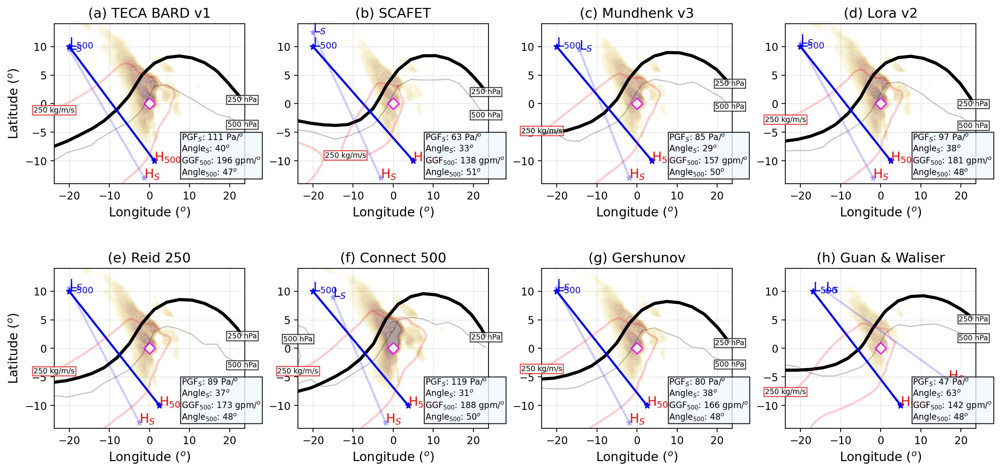

In [18]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['pv','z','msl','tcwv','ivt']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    
     #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    d2plot = eval(f'{alg}_merra')[f'omega']['OMEGA'].sel(lev=700)
    d2plot = d2plot.where(d2plot.values<0)
    percentile_85 = (-1*d2plot).quantile(0.90)

    d2plot=d2plot.where(d2plot<(-1*0.1))
    plot = d2plot.plot.contourf(ax=ax, levels=np.arange(-0.7,-0.09,0.04),
                      cmap=cmaps.brown_peachy,alpha=0.5, add_colorbar=False)#, norm=norm, levels=levels)
        
    
    #EPV @ 500 hPa
    #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    c1 = ax.contour(eval(f'{alg}_merra')[f'epv']['lon'].values[::5], eval(f'{alg}_merra')[f'epv']['lat'].values[::5], eval(f'{alg}_merra')[f'epv']['norm_EPV'].sel(lev=500).values[::5,::5], 
                    levels=[0], colors='black',alpha=0.25, linewidths=1)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

    #EPV @ 250 hPa
    c1 = ax.contour(eval(f'{alg}_merra')[f'epv']['lon'].values[::5], eval(f'{alg}_merra')[f'epv']['lat'].values[::5], eval(f'{alg}_merra')[f'epv']['norm_EPV'].sel(lev=250).values[::5,::5],
                    levels=[0], colors='black', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

    
  

    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
    msl_data = eval(f'{alg}_merra')[f'slp']['SLP'].sel(lon=slice(-20,20), lat=slice(-13,13))

    PGF, PD, D, angle, A, B, C = calc_pgf(msl_data)

    #ax.scatter(_xl,_yl, color='cyan')
    ax.text(A[0],A[1] , 'L$_{S}$', fontdict={'size':12,'color':'blue'})

    points_x = [A[0],B[0]]
    points_y = [A[1],B[1]]
    ax.text(B[0],B[1] , 'H$_{S}$', fontdict={'size':12, 'color':'red'})
    ax.plot(points_x,points_y, marker='*', color='blue',linewidth=2,alpha=0.2)

#     points_x = [A[0],C[0]]
#     points_y = [A[1],C[1]]
#     ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='blue',alpha=0.2,linewidth=0.5)

#     points_x = [C[0],B[0]]
#     points_y = [C[1],B[1]]
#     ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='blue',alpha=0.2,linewidth=0.5)

#     # Create a curve around corner A
#     radius = 5  # Radius of the curve
#     theta = np.linspace((3/2)*np.pi, (3/2)*np.pi + np.radians(angle),  100)  # Angle range for the curve
#     x_curve = A[0] + radius * np.cos(theta)
#     y_curve = A[1] + radius * np.sin(theta)
#     ax.plot(x_curve, y_curve, color='blue',alpha=0.2, label='Curve around corner A')



    # Plot the triangle and the midpoint of line AB
    #midpoint_AB = ((A[0] + B[0]) / 2, (A[1] + B[1]) / 2)
    #ax.plot(midpoint_AB[0], midpoint_AB[1], marker='*',color='red' )  # Mark midpoint of line AB

    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)

    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)

    epv500 = eval(f'{alg}_merra')[f'h']['H'].sel(lev=500,lon=slice(-20,20), lat=slice(-10,10))*10#/1e-7
    PGF500, PD500, D500, angle500, A500, B500, C500 = calc_pgf(epv500)

    #ax.scatter(_xl,_yl, color='cyan')
    ax.text(A500[0],A500[1] , 'L$_{500}$', fontdict={'size':12,'color':'blue'})

    points_x = [A500[0],B500[0]]
    points_y = [A500[1],B500[1]]
    ax.text(B500[0], B500[1] , 'H$_{500}$', fontdict={'size':12, 'color':'red'})
    ax.plot(points_x,points_y, marker='*', color='blue',linewidth=2)

#     points_x = [A500[0],C500[0]]
#     points_y = [A500[1],C500[1]]
#     ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='blue',linewidth=0.5)

#     points_x = [C500[0],B500[0]]
#     points_y = [C500[1],B500[1]]
#     ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='blue',linewidth=0.5)

#     # Create a curve around corner A
#     radius = 5  # Radius of the curve
#     theta = np.linspace((3/2)*np.pi, (3/2)*np.pi + np.radians(angle500),  100)  # Angle range for the curve
#     x_curve = A500[0] + radius * np.cos(theta)
#     y_curve = A500[1] + radius * np.sin(theta)
#     ax.plot(x_curve, y_curve, color='blue')

    try:
        #IVT CONTOUR 250kg/m/s
        d2plot = eval(f'{alg}_merra')[f'ivt']['IVT']
        c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='red', alpha=0.2,linestyles='solid',linewidths=2)
        
        #IVT CONTOUR 250kg/m/s
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='red', alpha=0.7,pad=1))
        #IVT CONTOUR 500kg/m/s
        c1=ax.contour(d2plot['lon'], d2plot['lbat'], d2plot, levels=[500], colors='red', linestyles='solid',linewidths=2)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 kg/m/s',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='red', alpha=0.7,pad=1))
    except:
        pass
    # Add text boxes with specified content
    ax.text(8, -12.5, f'PGF$_S$: '+f'{round(float(PGF))} Pa/$^o$ \n' + 'Angle$_S$: '+f'{round(angle)}$^o$ \n'+ 'GGF$_{500}$: '+f'{int(PGF500)} gpm/$^o$ \n'+'Angle$_{500}$: '+f'{round(angle500)}$^o$' , 
            fontsize=8, bbox=dict(facecolor='#F0F8FF', alpha=0.8,pad=1))  # PGF_surface textbox

    ax.grid(linewidth=0.2)
    #totals = len_of_data[ix]
    #elem = clust[1]
    #perc = (elem/totals) * 100
    ax.set_title(f'({convert(ix)}) {alg_names[ix]}',fontsize=13)
    ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
    ax.scatter(0,0,color='white', marker='D', s=30)
#plt.savefig(f'Images/kmeans_Cluster_stats_new.pdf',dpi=300)

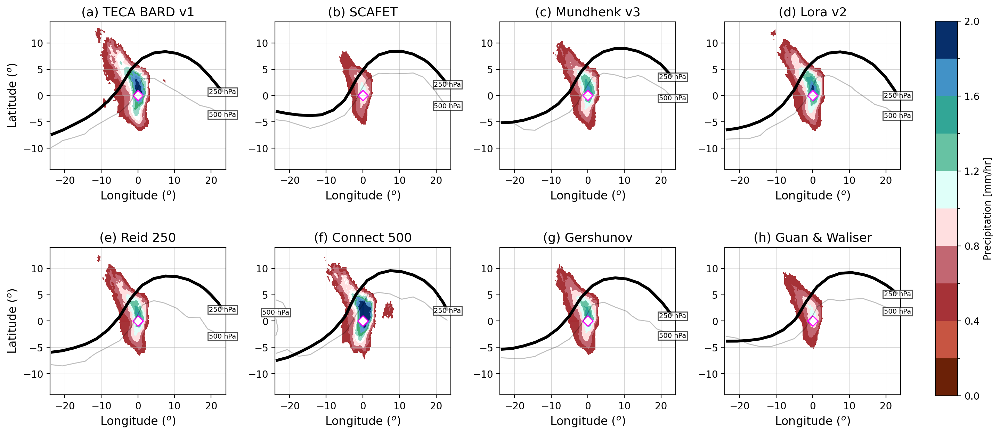

In [23]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['pv','precipitationCal']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    
     #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    d2plot = eval(f'{alg}_merra')[f'precipitationCal']['PRECIPITATIONCAL']

    d2plot=d2plot.where(d2plot>(0.4))
    plot = d2plot.plot.contourf(ax=ax, levels=np.arange(0,2.1,0.2),
                      cmap=cmaps.precip4_diff_19lev,alpha=1, add_colorbar=False)#, norm=norm, levels=levels)
    
    #EPV @ 500 hPa
    #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    c1 = ax.contour(eval(f'{alg}_merra')[f'epv']['lon'].values[::5], eval(f'{alg}_merra')[f'epv']['lat'].values[::5], eval(f'{alg}_merra')[f'epv']['norm_EPV'].sel(lev=500).values[::5,::5], 
                    levels=[0], colors='black',alpha=0.25, linewidths=1)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

    #EPV @ 250 hPa
    c1 = ax.contour(eval(f'{alg}_merra')[f'epv']['lon'].values[::5], eval(f'{alg}_merra')[f'epv']['lat'].values[::5], eval(f'{alg}_merra')[f'epv']['norm_EPV'].sel(lev=250).values[::5,::5],
                    levels=[0], colors='black', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)

    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)


    ax.grid(linewidth=0.2)
    #totals = len_of_data[ix]
    #elem = clust[1]
    #perc = (elem/totals) * 100
    ax.set_title(f'({convert(ix)}) {alg_names[ix]}',fontsize=13)
    ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
    ax.scatter(0,0,color='white', marker='D', s=30)
cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5, label='Precipitation [mm/hr]')
plt.savefig(f'Images/precipitation_all_new.pdf',dpi=300)

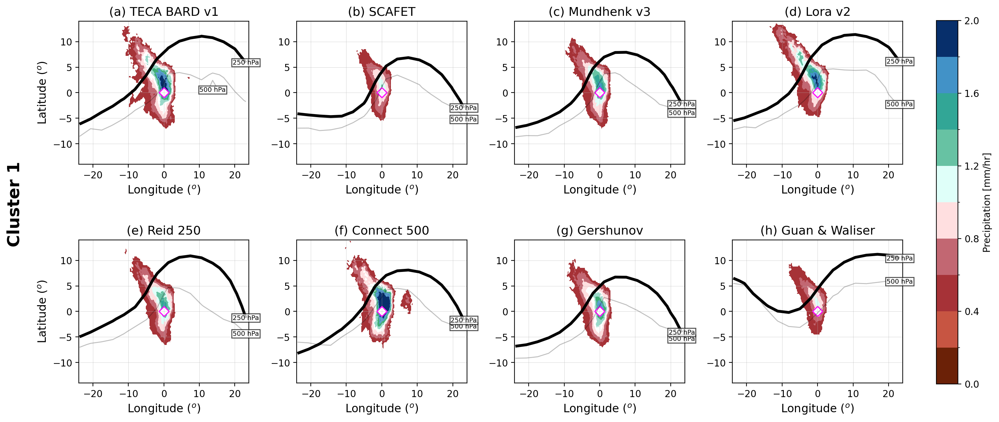

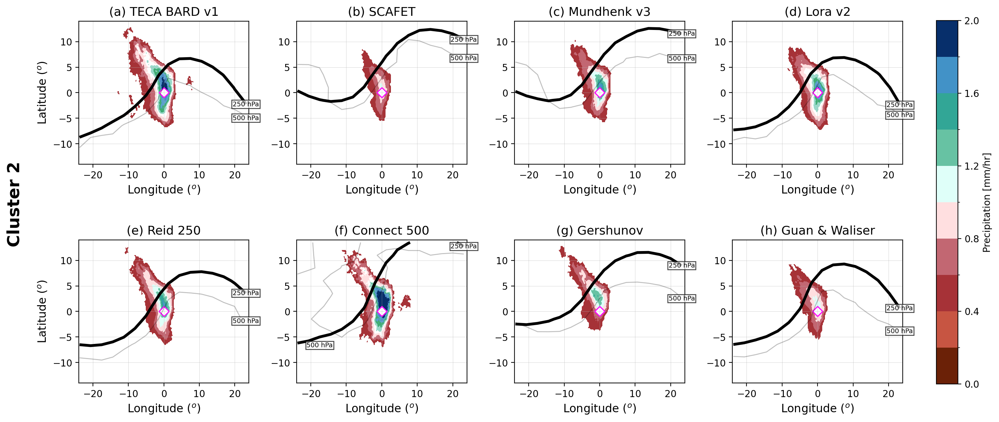

In [26]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['pv','precipitationCal']

for nx in range(0,2):
    fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)

    for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################

         #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        d2plot = eval(f'{alg}_merra')[f'precipitationCal_{nx}']['PRECIPITATIONCAL']

        d2plot=d2plot.where(d2plot>(0.4))
        plot = d2plot.plot.contourf(ax=ax, levels=np.arange(0,2.1,0.2),
                          cmap=cmaps.precip4_diff_19lev,alpha=1, add_colorbar=False)#, norm=norm, levels=levels)

        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{nx}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{nx}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{nx}']['norm_EPV'].sel(lev=500).values[::5,::5], 
                        levels=[0], colors='black',alpha=0.25, linewidths=1)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{nx}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{nx}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{nx}']['norm_EPV'].sel(lev=250).values[::5,::5],
                        levels=[0], colors='black', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)
       
        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        if ix ==4:
                ax.text(-0.1, 1.25, f'Cluster {nx+1}\n \n \n \n \n', va='center', ha='center', rotation='vertical', 
                    transform=ax.transAxes,fontsize=18, fontweight='bold')

        ax.grid(linewidth=0.2)
        
        ax.set_title(f'({convert(ix)}) {alg_names[ix]}',fontsize=13)
        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
        ax.set_ylim(-14,14)
        ax.set_xlim(-24,24)
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5, label='Precipitation [mm/hr]')
    plt.savefig(f'Images/precipitation_c{nx+1}_new.pdf',dpi=300)

## IDEA 

* create a cluster using all the datasets in the 8 algorithms
* plot the datasets and save the images and use it as the target for image classification. 
* make an image classification script using machine learning image processing and reclassify the datasets based on the categories they fall in for each ARDT individually 

In [3]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score


In [22]:
#K=np.arange(2,10)
silhouette_scores=[]

scaler = StandardScaler()
#####################################################################################
# Note to self: To do the pv and sh stacking for kmeans computation, I have to make the data into 2D. So #
# I first concat along the longitude or latitude (based on which transects), then collapse the lon and lat di-  #
# mensions. This gives an array index of ntime, 2*lon*lat. I do this in the next 2 lines of code                      #
####################################################################################
data1= cascade_bard_v1_merra['epv']['EPV']
data2 = cascade_bard_v1_merra['ivt']['IVT']
new_data = xr.concat([data1,data2],dim=['lat','lon']) #reshape using this! More memory efficient
#new_data = np.reshape(trans_data.values,(len(trans_data.time.values),len(trans_data.level)*len(trans_data[tloc].values)))
ddss = new_data
new_data = new_data.stack(lev_lat=('lev', 'lon','lat','concat_dim')).transpose('time', 'lev_lat') #reshape using this! More memory efficient
#new_data = np.reshape(new_data.values,(len(trans_data.time.values),len(trans_data.level)*len(trans_data[tloc].values)))


print('Scaling data')
scaled_data = np.nan_to_num(np.array((new_data-new_data.mean('time'))/new_data.std('time')),nan=0) #not memory efficient but faster and also replaces nans with 0
#scaled_data = scaler.fit_transform(new_data) #this method is memory efficient bit takes longer time 
k=4
#for k in K:
print(f'Starting K-means {k}')
kmeans = KMeans(n_clusters=k, random_state=0)

print('Fitting scaled data')
clustered_data = kmeans.fit_predict(scaled_data)
#silhouette_avg = silhouette_score(scaled_data, clustered_data)
print('starting silhouette score')
#silhouette_scores.append(silhouette_avg)
#sse.append(kmeans.inertia_)

Scaling data
Starting K-means 4
Fitting scaled data
starting silhouette score


In [9]:
for k in K:
    print(f'Starting K-means {k}')
    kmeans = KMeans(n_clusters=k, random_state=0)

    print('Fitting scaled data')
    clustered_data = kmeans.fit_predict(scaled_data)
    silhouette_avg = silhouette_score(scaled_data, clustered_data)
    silhouette_scores.append(silhouette_avg)
    #sse.append(kmeans.inertia_)

Starting K-means 2
Fitting scaled data


TypeError: 'list' object is not callable

# DO NOT RERUN !! 

In [1]:
exec(open('imports.py').read())
from tqdm import tqdm 
from numba import njit

ERROR 1: PROJ: proj_create_from_database: Open of /global/homes/k/kquagra/miniconda3/envs/climate_py311.5/share/proj failed


In [2]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
total_scaled = []

#opem cluster data and obtain the cluster list 
with open('cluster_numbers/cluster_values_all_ardts','r') as f:
    lines = f.readlines()
lines = [int(x[0]) for x in lines]

In [169]:
#load data from merra and assign the cluster numbers to the data for all ARDTs 
#obtain the mid point of the combined ARDTs data
variables = ['ivt']#,'slp','tqv']#['h','epv','omega']
mpath='./MERRA2/'
for vx,vb in enumerate(variables):
    len_of_data = []

    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{vb.upper()}{Color.END}')
    ct=0
    total_data = []
    for alx, alg in enumerate(algorithms):
        
        #locals()[f'{alg}_merra'] = collections.defaultdict(list)
        print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
        
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        ds = xr.open_mfdataset(pths, chunks='auto')
        print('Done loading data \nCalculating mean')
        
        #ds['time'] = lines[ct:ct+len(ds.time.values)]
        #ct = ct + len(ds.time.values)
        #prev_ct.append(ct)
        
        total_data.append(ds)
    ds = xr.concat(total_data,dim='time')
    ds['time'] = lines
    
    #use this to generate time averages for plotting 
    #ds = ds.groupby('time').mean('time')     
    
    #use this for median value for the dataset for normalisation point 0
    ds = ds.groupby('time').mean('time').median(['lon','lat'])#.mean()
    locals()[f'{vb.upper()}_data_raw'] = ds#.load()
    #= lines 
    
        #if vx == 0 :
        #    len_of_data.append(len(ds.time.values))

IVT
CASCADE_BARD_V1
Done loading data 
Calculating mean
SCAFET
Done loading data 
Calculating mean
MUNDHENK_V3
Done loading data 
Calculating mean
LORA_V2
Done loading data 
Calculating mean
REID250
Done loading data 
Calculating mean
CONNECT500
Done loading data 
Calculating mean
GERSHUNOV
Done loading data 
Calculating mean
GUAN_WALISER
Done loading data 
Calculating mean


In [174]:
IVT_data_raw['IVT'][2].values#.mean().values#.median(axis=0).values

array(119.53099909)

In [46]:
sv_pth = './cluster_numbers/'
variables = ['ivt','slp','tqv']

for vb in variables:
    eval(f'{vb.upper()}_data').to_netcdf(f'all_algo_{vb.upper()}_avg_cluster.nc')


# BAROTROPIC PROOF
### Identify the barotropic nature of the entire ARDTs as a confirmation that they indeed capture different phases of barotropic waves 
* Normalise dataset to range between - 1 and 1 
### $\text{normalized_value} = \frac{2 \times (\text{value} - \text{min})}{\text{max} - \text{min}} - 1$

* Plot data and use the 0 point of the data to trace the wave pattern and region of highest gradient



In [1]:
import colormaps as cmaps

In [3]:
# Define a function to normalize each variable in the dataset
def normalize_variable(var, var_type):
    ''' 
    This function normalises an xarray dataset for values between -1 and 1. 
    
    Arguments
    --------------
    
    var : xarray dataset or data array
    
    Return
    ----------
    
    xarray normalised dataset
    
    '''
    if var_type == 'levels':
        
        min_val = var.min(dim=['time','lon','lat'])    #obtain min value
        #print(min_val.values)
        max_val = var.max(dim=['time','lon','lat'])   # obtain max value
    elif var_type != 'levels':
        min_val = var.min()    #obtain min value  dim=['longitude','laitude']
        #print(min_val.values)
        max_val = var.max()   # obtain max value
        
    normalized_var = 2 * (var - min_val) / (max_val - min_val) - 1    #compute normalisation
    
    return normalized_var

In [4]:
# Load datasets 
variables = ['h','epv','omega'] 
mpath = 'all_ARDTs_cluster_data/'

for vb in variables:
    ds =  xr.open_mfdataset(f'{mpath}*{vb.upper()}*.nc')
    
    norm_data= normalize_variable(ds,var_type='levels')
    locals()[f'{vb.upper()}_data'] = norm_data 
    
    

variables = ['ivt','slp','tqv'] 

for vb in variables:
    print(vb)
    ds =  xr.open_mfdataset(f'{mpath}*{vb.upper()}*.nc')
    
    norm_data= normalize_variable(ds,var_type='surface')
    locals()[f'{vb.upper()}_data'] = norm_data 
    

ivt
slp
tqv


In [5]:
##############################################################################################################################
#load data from merra and assign the cluster numbers to the data for all ARDTs 
##############################################################################################################################
# COMPUTE MEDIAN VALUES 
##############################################################################################################################
#obtain the mid point of the combined ARDTs data
##############################################################################################################################
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
variables = ['ivt']#,'slp','tqv']#['h','epv','omega']
mpath='./MERRA2/'
for vx,vb in enumerate(variables):
    len_of_data = []

    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{vb.upper()}{Color.END}')
    ct=0
    total_data = []
    for alx, alg in enumerate(algorithms):
        
        #locals()[f'{alg}_merra'] = collections.defaultdict(list)
        print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
        
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        ds = xr.open_mfdataset(pths, chunks='auto')
        print('Done loading data \nCalculating mean')
        
        #ds['time'] = lines[ct:ct+len(ds.time.values)]
        #ct = ct + len(ds.time.values)
        #prev_ct.append(ct)
        
        total_data.append(ds)
    ds = xr.concat(total_data,dim='time')
    ds['time'] = lines
    
    #use this to generate time averages for plotting 
    #ds = ds.groupby('time').mean('time')     
    
    #use this for median value for the dataset for normalisation point 0
    ds = ds.groupby('time').mean('time').median(['lon','lat'])#.mean()
    locals()[f'{vb.upper()}_data_raw'] = ds#.load()
    #= lines 
    
        #if vx == 0 :
        #    len_of_data.append(len(ds.time.values))

IVT
CASCADE_BARD_V1
Done loading data 
Calculating mean
SCAFET
Done loading data 
Calculating mean
MUNDHENK_V3
Done loading data 
Calculating mean
LORA_V2
Done loading data 
Calculating mean
REID250
Done loading data 
Calculating mean
CONNECT500
Done loading data 
Calculating mean
GERSHUNOV
Done loading data 
Calculating mean
GUAN_WALISER
Done loading data 
Calculating mean


In [6]:
ivt_medians = [str(round(x,0)) for x in IVT_data_raw['IVT'].values]

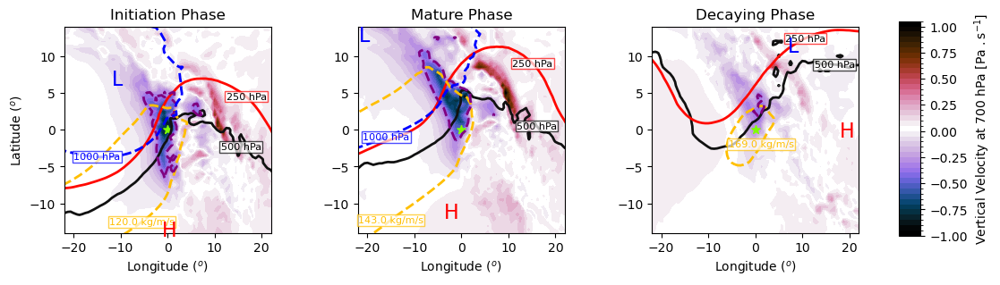

In [13]:
fig,axes = plt.subplots(ncols=3, figsize=(12,3))
cl_num = [2,0,1]
titles = ['Initiation Phase' , 'Mature Phase', 'Decaying Phase']
for ix,ax,(tx,tits) in zip(cl_num,axes.flat, enumerate(titles)):

    plot = OMEGA_data['OMEGA'].sel(lev=850, time = ix).plot.contourf(ax=ax, cmap=cmaps.emergency,vmin=-1,vmax=1,levels=np.arange(-1,1.1,0.05), add_colorbar=False) 
      
    
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    #EPV @ 500 hPa
    c1 = ax.contour(EPV_data['EPV']['lon'], EPV_data['EPV']['lat'], EPV_data['EPV'].sel(lev=500, time = ix), levels=[0], colors='#111111', linewidths=2)
    x,y= c1.get_paths()[0].vertices[120]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=8,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))
    
    #EPV @ 250 hPa
    c1 = ax.contour(EPV_data['EPV']['lon'], EPV_data['EPV']['lat'], EPV_data['EPV'].sel(lev=250, time = ix), levels=[0], colors='#FF0800', linewidths=2)
    x,y= c1.get_paths()[0].vertices[100]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=8,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='red', alpha=0.7,pad=1))
    
    
    #IVT
    c1 = ax.contour(IVT_data['IVT']['lon'], IVT_data['IVT']['lat'], IVT_data['IVT'].sel( time = ix), levels=[0], linestyles = 'dashed',colors='#FFBF00', linewidths=2)
    try:  
        x,y= c1.get_paths()[0].vertices[15]#.mean(axis=0)   
        ax.text(x,y, f'{ivt_medians[ix]} kg/m/s',
                color='#FFBF00',
                fontsize=8,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#FFBF00', alpha=0.7,pad=1))
    except:
        pass
    
    #OMEGA @ 850 hPa
    ax.contour(OMEGA_data['OMEGA']['lon'], OMEGA_data['OMEGA']['lat'], OMEGA_data['OMEGA'].sel(lev=850, time = ix), levels=[-0.35], linestyles = 'dashed', colors='purple', linewidths=2)
    
    c1 = ax.contour(SLP_data['SLP']['lon'], SLP_data['SLP']['lat'], SLP_data['SLP'].sel(time = ix), levels=[0], linestyles = 'dashed',colors='#0000FF', linewidths=2)
    try:  
        x,y= c1.get_paths()[0].vertices[-20]#.mean(axis=0)   
        ax.text(x,y, '1000 hPa',
                color='blue',
                fontsize=8,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='blue', alpha=0.7,pad=1))
    except:
        pass
    
    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
    msl_data = SLP_data['SLP'].sel(time=ix).sel(lon=slice(-22,22),lat=slice(-14.5,14.5))
    mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'], msl_data.argmin(dim=['lon','lat'])['lat']    #obtain the lows positions 
    xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'],msl_data.argmax(dim=['lon','lat'])['lat']      #obtain the highs positions

    _text_data = msl_data.isel(lon=mln.values,lat=mlt.values)       #select the data for lows 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
    if _x >= msl_data.lat.max().values - 0.5:
        _x = _x -2
    if _y >= msl_data.lat.max().values - 0.5:
        _y = _y - 2
    ax.text(_x,_y , 'L', fontdict={'size':16,'color':'blue'})

    _text_data = msl_data.isel(lon=xln.values,lat=xlt.values)       #select the data for highs 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
    if _x >= msl_data.lon.max().values-0.5:
        _x = _x - 4
    if _y >= msl_data.lat.max().values-0.5:
        _y = _y - 1

    ax.text(_x,_y , 'H', fontdict={'size':16, 'color':'red'})
    ##############################################################################################################################
    ##############################################################################################################################
    ax.set_box_aspect(1)
    ax.set_ylim(-14,14)
    ax.set_xlim(-22,22)
    ax.set_title(tits)
    
    if tx == 0:
        ax.set_ylabel('Latitude ($^o$)')
    else:
        ax.set_ylabel('')
    
    ax.set_xlabel('Longitude ($^o$)')
    
    ax.scatter(0,0,marker='*', color='#80FF00', s=50)
    
cbar_ax = fig.add_axes([0.92, 0.1, 0.02, 0.8])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Vertical Velocity at 700 hPa [Pa $.$s$^{-1}$]')
#plt.savefig('Images/AR_phases.png', dpi=300)

## CREATE LOOP FOR TIME LAGS

### USE THIS TO PREPROCESS THE DATA INTO THE AVERAGES AND LOAD FOR EASY PLOTTING 

In [8]:
import dask 
import dask.delayed
# Define a function to normalize each variable in the dataset
@dask.delayed
def normalize_variable(var, var_type):
    ''' 
    This function normalises an xarray dataset for values between -1 and 1. 
    
    Arguments
    --------------
    
    var : xarray dataset or data array
    
    Return
    ----------
    
    xarray normalised dataset
    
    '''
    if var_type == 'levels':
        
        min_val = var.min(dim=['lon','lat'])    #obtain min value
        #print(min_val.values)
        max_val = var.max(dim=['lon','lat'])   # obtain max value
    elif var_type == 'surface':
        min_val = var.min()    #obtain min value  dim=['longitude','laitude']
        #print(min_val.values)
        max_val = var.max()   # obtain max value
        
    normalized_var = 2 * (var - min_val) / (max_val - min_val) - 1    #compute normalisation
    
    return normalized_var

In [5]:
levs_2_plot = [850,700,500,300,250]

In [11]:

##################################################################################################
#                                                         Load data for lagged Kmeans dataset and store them                                                  #
##################################################################################################

algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables =['epv','slp','ivt'] #['h','epv','omega','ivt','slp','tqv']
types = ['levels','surface','surface']
len_of_data = []
groups = np.arange(0,2)
lags = [2,4]#,6,12,18,24]
typ='surface'
for lg in lags:
    print(f'Loading and Normalising for lag{lg}')
    mpath=f'./MERRA2-lagged/lag_{lg}hrs/'
    for alx, alg in enumerate(algorithms):
        locals()[f'{alg}_merra'] = collections.defaultdict(list)
        print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
        for typ, (vx,vb) in zip(types, enumerate(variables)):
            pths = glob.glob(f'{mpath}conus_ARS_DJF_lag_{alg}_{vb}_raw/*.nc',recursive=True)
            pths.sort()
            #ds = [xr.open_dataset(pt, chunks='auto') for pt in pths]
            #ds = xr.concat(ds,dim='time')
            ds = xr.open_mfdataset(pths, chunks='auto')
            print('Done loading data \nCalculating mean')

            with open(f'cluster_numbers/cluster_values_{alg}') as clusters:
                cluster = clusters.readlines()
                cluster = [int(x[0]) for x in cluster]
            print(len(cluster))

            ds['time'] = cluster

            print('Loading for groups')
            groups = ds.groupby('time').groups.keys()
            for gr in groups:
                if typ == 'levels':
                    dds = ds.sel(lev=levs_2_plot, time=gr).mean('time').load()
                elif typ == 'surface':
                    dds = ds.sel(time=gr).mean('time').load()

                #eval(f'{alg}_merra')[f'{vb}_c{gr}'] = dds   #.load()  #xr.open_mfdataset(pths, chunks='auto')
                sv_path = f'Averages/'


                print('Calculating normalisations')
                dds[f'norm_{vb.upper()}'] = normalize_variable(dds,var_type=typ).compute()[vb.upper()]

                sv_path=f'{mpath}Averages/'
                final_path = f'{sv_path}{alg}_cluster/'

                if os.path.isdir(sv_path) == False:
                    os.mkdir(sv_path)

                if os.path.isdir(final_path) == False:
                    os.mkdir(final_path)

                dds.to_netcdf(f'{final_path}{alg}_cluster{gr}_{vb}.nc')


            #print(len(pths))

            #if vx == 0 :
                #len_of_data.append(len(ds.time.values))

Loading and Normalising for lag2
CASCADE_BARD_V1
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
Calculating normalisations
SCAFET
Done loading data 
Calculating mean
26310
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
26310
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
26310
Loading for groups
Calculating normalisations
Calculating normalisations
MUNDHENK_V3
Done loading data 
Calculating mean
16601
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
16601
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading da

In [10]:
ds

<xarray.Dataset>
Dimensions:  (lat: 61, lon: 81, time: 6324)
Coordinates:
  * lat      (lat) float64 -15.0 -14.5 -14.0 -13.5 -13.0 ... 13.5 14.0 14.5 15.0
  * lon      (lon) float64 -25.0 -24.38 -23.75 -23.12 ... 23.12 23.75 24.38 25.0
  * time     (time) datetime64[ns] 1980-01-01 ... 2016-01-04T15:00:00
Data variables:
    SLP      (time, lat, lon) float32 dask.array<chunksize=(369, 61, 81), meta=np.ndarray>

### LOAD DATASETS

In [51]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['epv','ivt','slp']#,'h','omega','slp','tqv','ivt']
groups = np.arange(0,2)
lags = [2,4,6,12,18,24]
for lg in lags:
    mpath=f'./MERRA2-lagged/lag_{lg}hrs/'
    for alx,alg in enumerate(algorithms):
        
        #locals()[f'{alg}_merra'] = collections.defaultdict(list)

        for vx,vb in enumerate(variables):

            for gr in groups:
                pths = glob.glob(f'{mpath}Averages/{alg}_cluster/*{gr}_{vb}*', recursive=True)

                if vb == 'tqv':
                    ds = xr.open_mfdataset(pths).sel(longitude=slice(-24,24),latitude=slice(-14,14))
                else:
                    ds = xr.open_mfdataset(pths).sel(lon=slice(-24,24),lat=slice(-14,14))
                eval(f'{alg}_merra')[f'{vb}lg_{lg}_{gr}'] = ds

CPU times: user 2.69 s, sys: 1.06 s, total: 3.75 s
Wall time: 4.21 s


In [566]:
 fmt = mtk.StrMethodFormatter("{x:1.0f} m")
            z_plot = eval(f'{alg}_merra')[f'h_{clust[0]}']
            z1 = z_plot['H'].sel(lev=500).plot.contour(ax=ax,
                                                    vmin=5000,vmax=6000, levels=np.arange(5000,6000,80),
                                              cmap='black',linestyles='dashed',linewidths=1)
            z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)

            z1 = z_plot['H'].sel(lev=850).plot.contour(ax=ax,
                                                    vmin=1000,vmax=2000, levels=np.arange(1000,2000,50),
                                              cmap='white',linestyles='solid',linewidths=1)
            z1.clabel(fmt=fmt,inline = True,fontsize=9,rightside_up=True)

    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
            msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
            mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
            xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

            _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
            if _x >= msl_data.lat.max().values - 0.5:
                _x = _x -2
            if _y >= msl_data.lat.max().values - 0.5:
                _y = _y - 2
            ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

            _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
            if _x >= msl_data.lon.max().values-0.5:
                _x = _x - 4
            if _y >= msl_data.lat.max().values-0.5:
                _y = _y - 1

            ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

            if ix%4 ==0:
                ax.set_ylabel('Latitude ($^o$)', fontsize=12)

            else:
                ax.set_ylabel('')
            ax.set_xlabel('Longitude ($^o$)', fontsize=12)


array([[    0,  3060],
       [    1,  9741],
       [    1,  6914],
       [    0,  5426],
       [    0,  7076],
       [    1,  1223],
       [    1,  7433],
       [    0, 36191]])

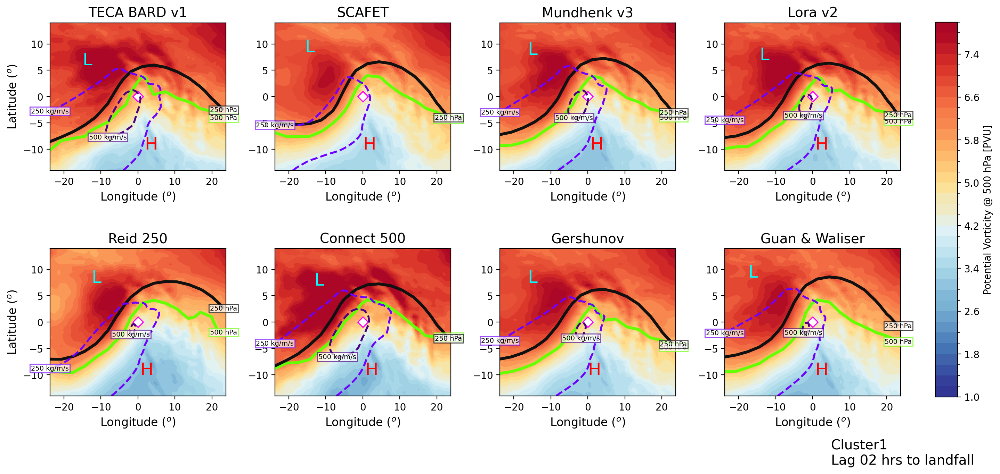

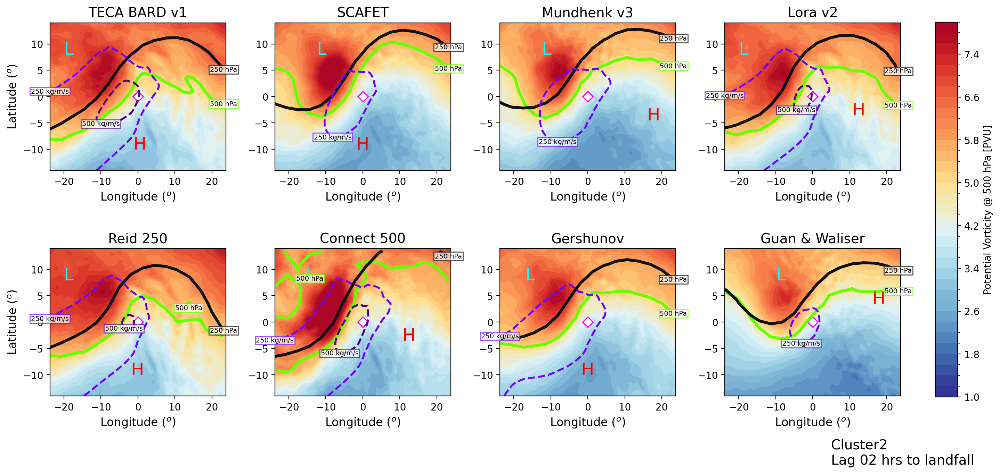

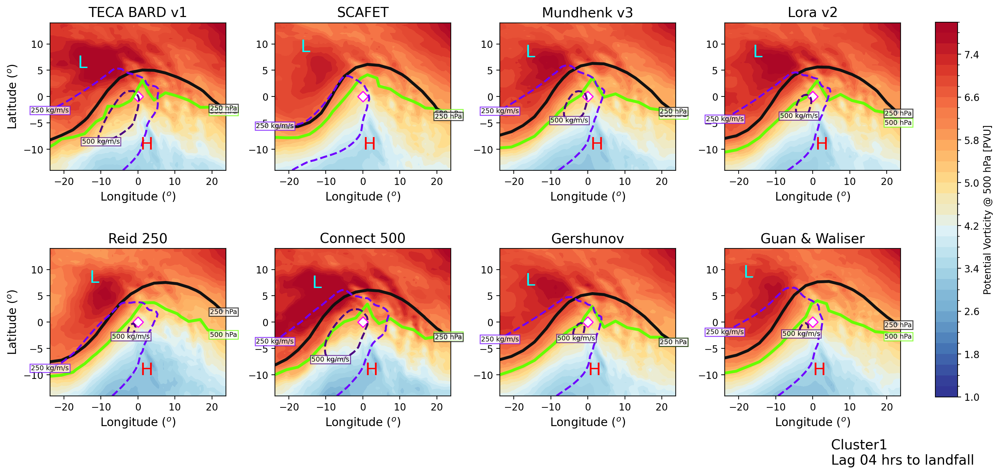

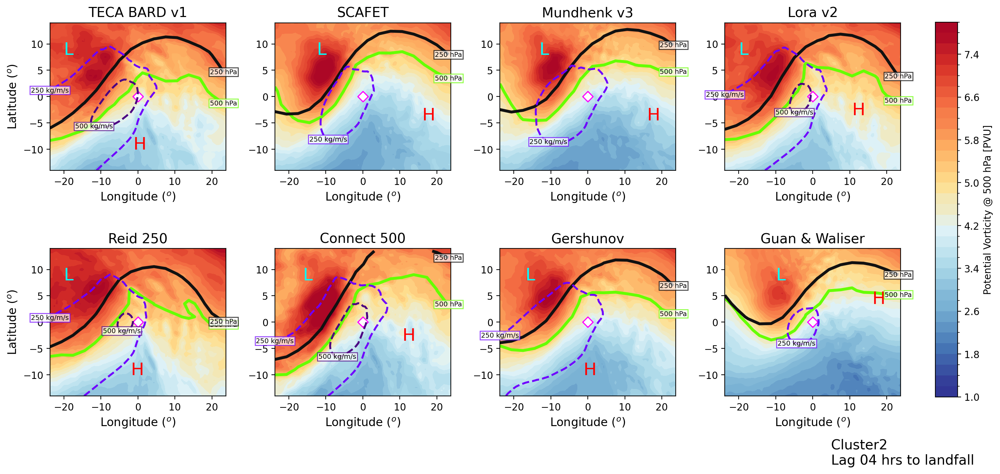

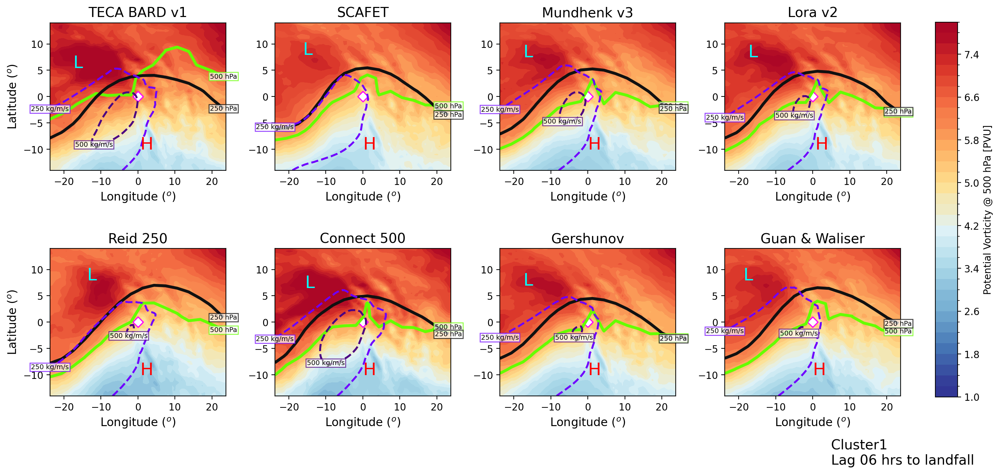

...

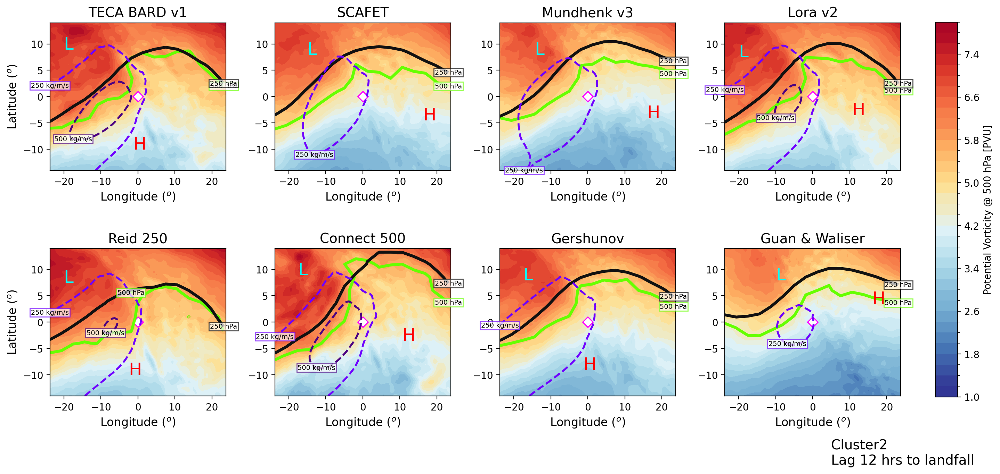

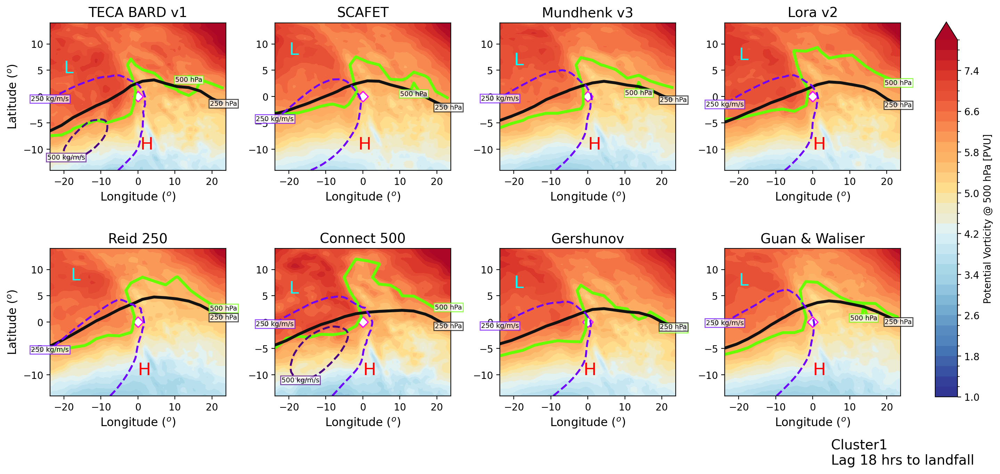

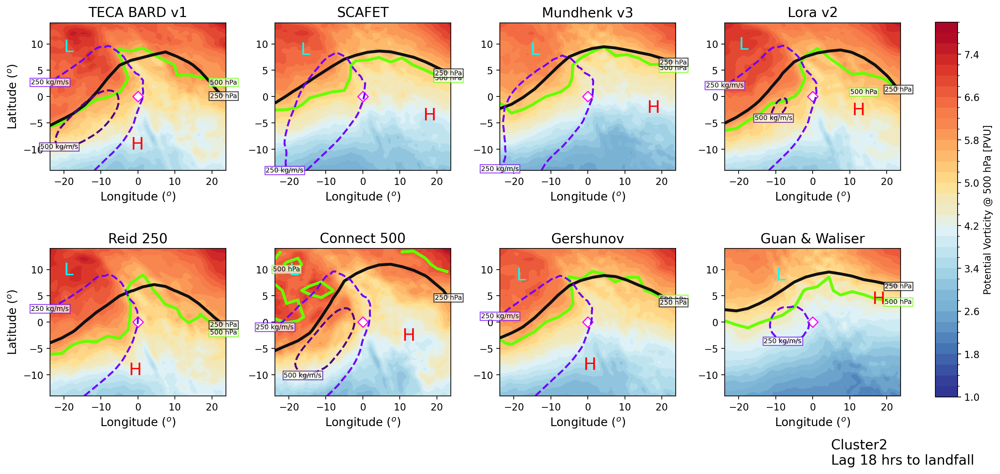

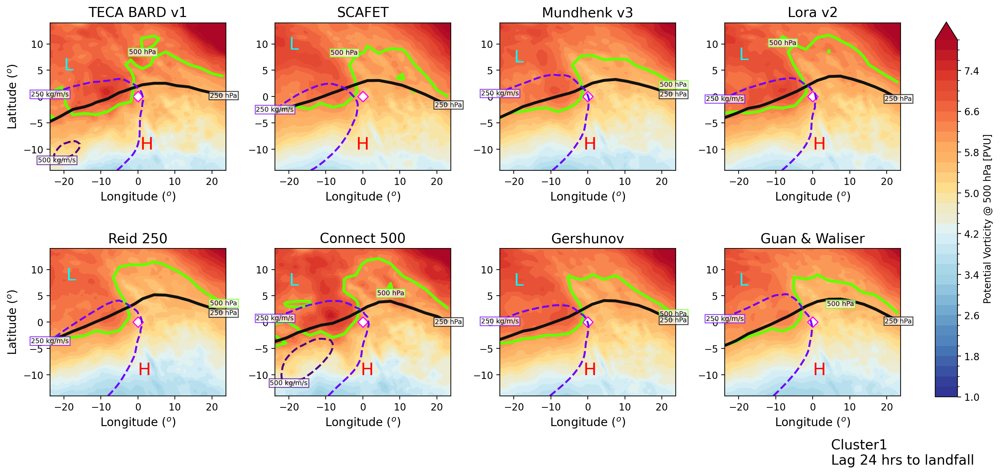

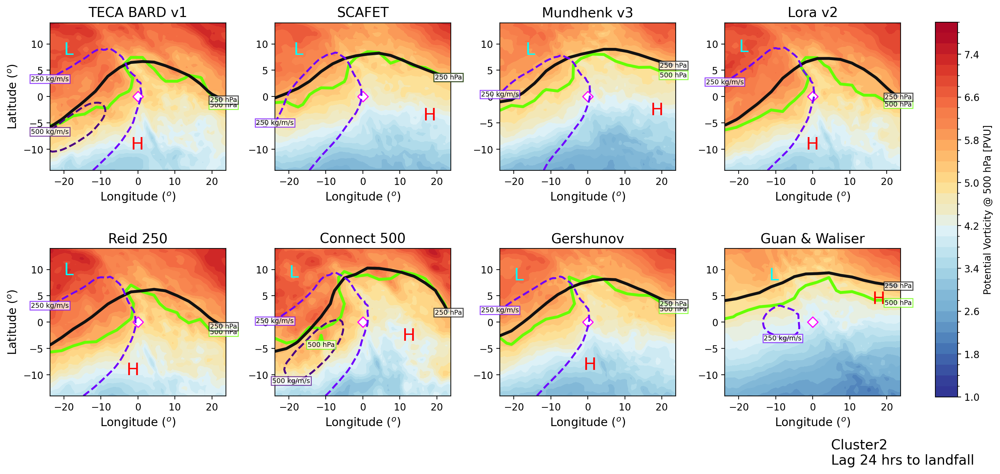

In [56]:
for lg in lags:
    
    for gr in groups:
    
        clus_2_plot = eval(f'cluster{gr+1}_len')
        fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
        plt.tight_layout(pad=12,h_pad=6,w_pad=2)

        for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
            d2plot = eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}'].sel(lev=500)/1e-7
            #d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7

            levs=np.arange(1,8.1,0.2)   # Adjust the number of levels as needed
            #norm = plt.Normalize(levels.min(), levels.max())

            plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)

            
            ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
            msl_data = eval(f'{alg}_merra')[f'slplg_{lg}_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
            mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
            xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

            _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
            if _x >= msl_data.lat.max().values - 0.5:
                _x = _x -2
            if _y >= msl_data.lat.max().values - 0.5:
                _y = _y - 2
            ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

            _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
            if _x >= msl_data.lon.max().values-0.5:
                _x = _x - 4
            if _y >= msl_data.lat.max().values-0.5:
                _y = _y - 1

            ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

            if ix%4 ==0:
                ax.set_ylabel('Latitude ($^o$)', fontsize=12)

            else:
                ax.set_ylabel('')
            ax.set_xlabel('Longitude ($^o$)', fontsize=12)

            ##############################################################################################################################
            #######################################  make contour plots for wave propagation at different levels  ########################################
            ##############################################################################################################################
            #EPV @ 500 hPa
            #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
            c1 = ax.contour(eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 hPa',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

            #EPV @ 250 hPa
            c1 = ax.contour(eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 hPa',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

            try:
                #IVT CONTOUR 250kg/m/s
                d2plot = eval(f'{alg}_merra')[f'ivtlg_{lg}_{clust[0]}']['IVT']
                c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='#6F00FF', linestyles='dashed',linewidths=2)
                x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
                ax.text(x,y, '250 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='#6F00FF', alpha=0.7,pad=1))
                #IVT CONTOUR 500kg/m/s
                c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='#4B0082', linestyles='dashed',linewidths=2)
                x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
                ax.text(x,y, '500 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='#4B0082', alpha=0.7,pad=1))
            except:
                pass

            ax.set_title(f'{alg_names[ix]}',fontsize=14)
            ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
            ax.scatter(0,0,color='white', marker='D', s=30)
            
        cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
        cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity @ 500 hPa [PVU]')
        ax.text(5, -27, f'Cluster{gr+1} \nLag {str(lg).zfill(2)} hrs to landfall', fontsize=14,fontname='sans-serif')
        
        plt.savefig(f'laggedimages/{str(lg).zfill(2)}hrs_{gr}.png', dpi=300)


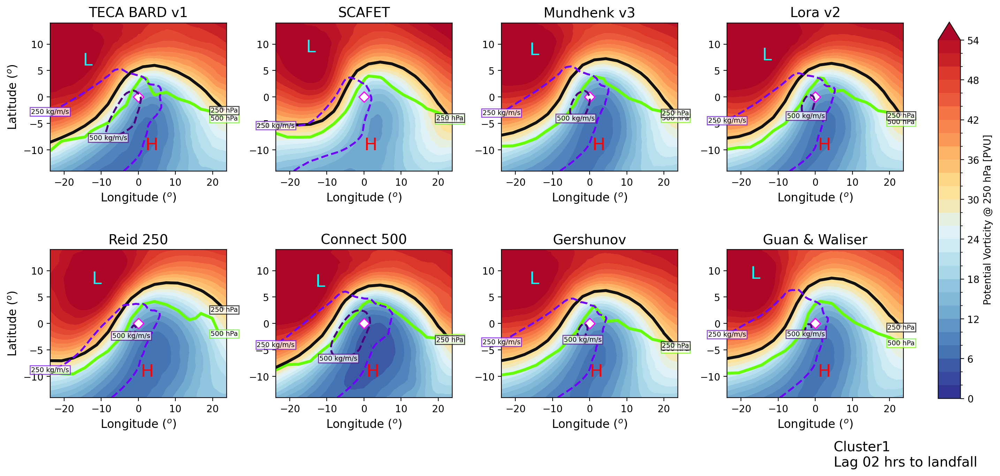

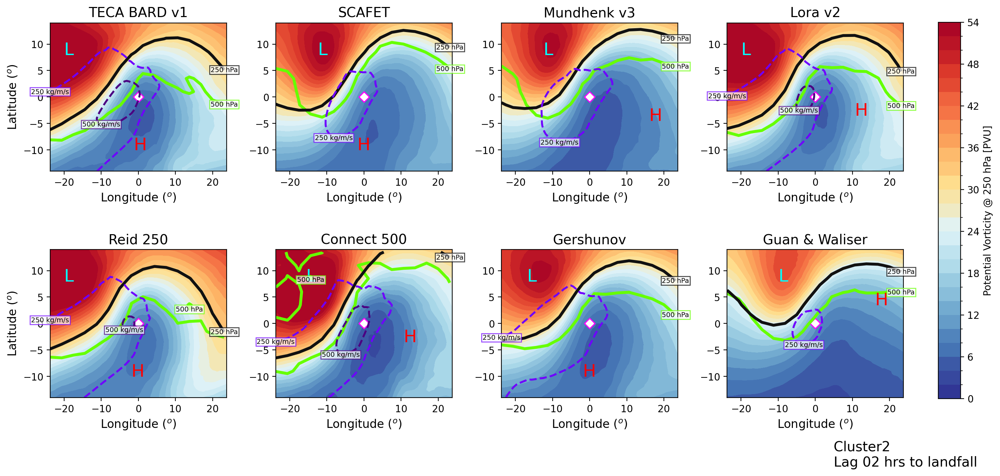

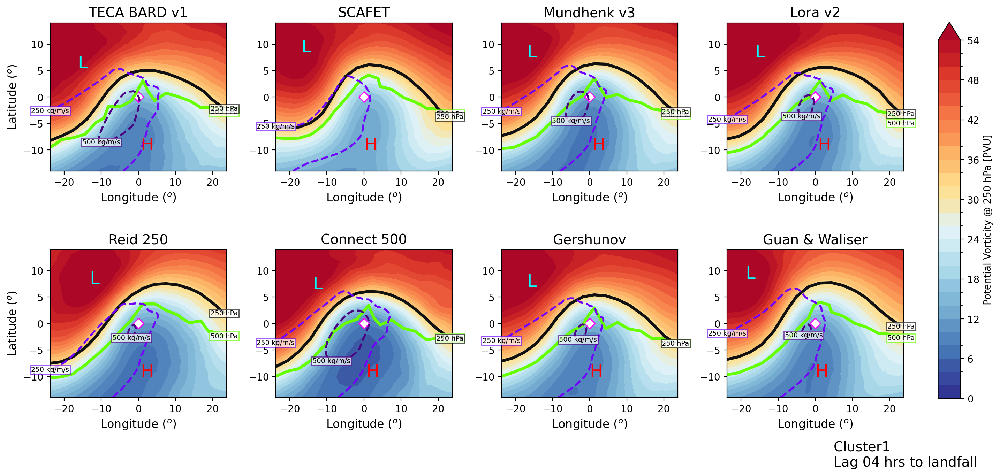

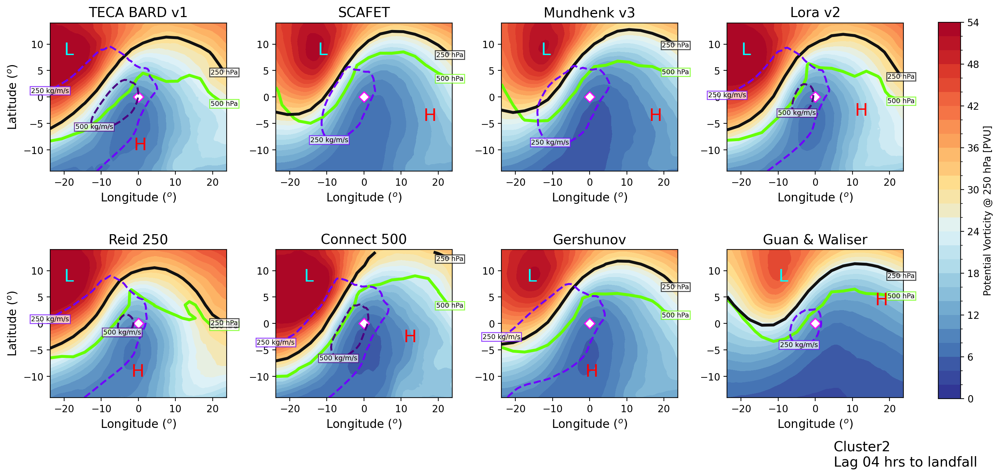

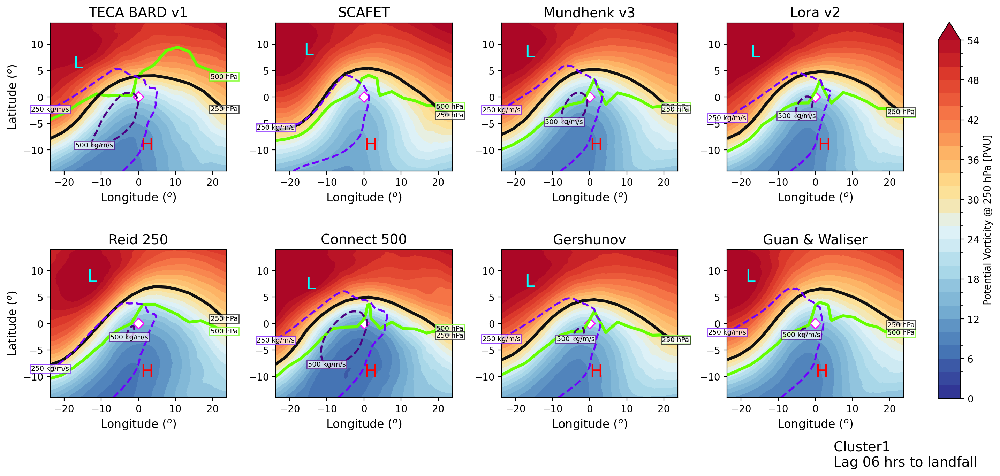

...

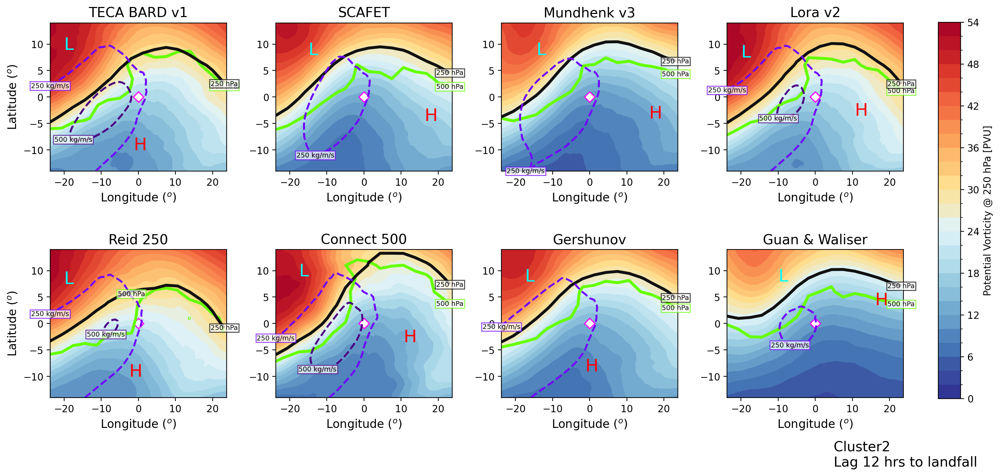

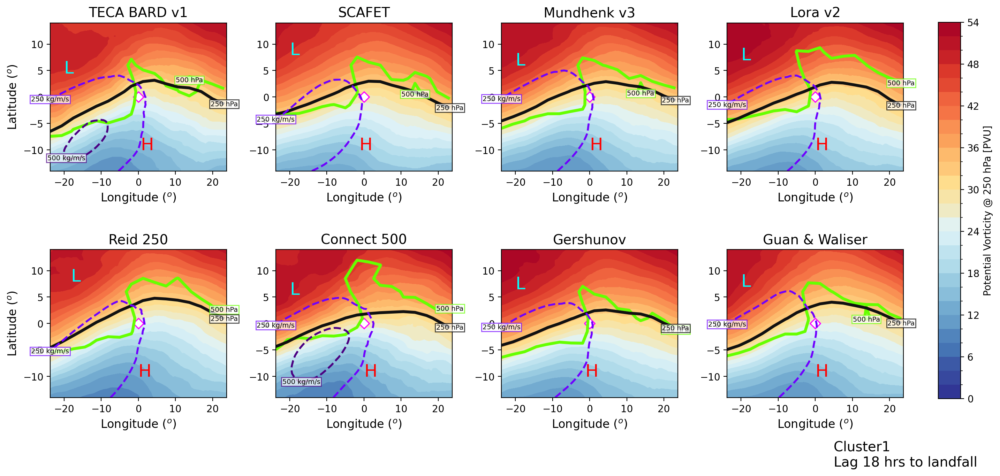

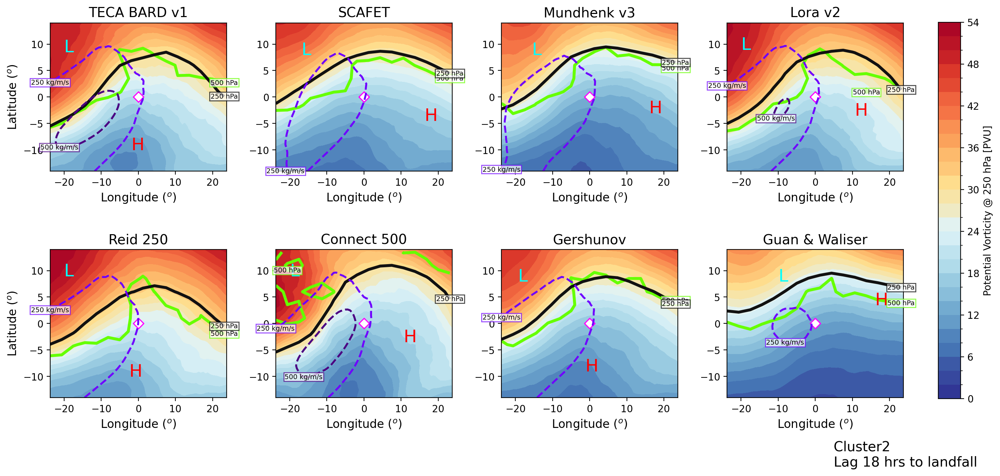

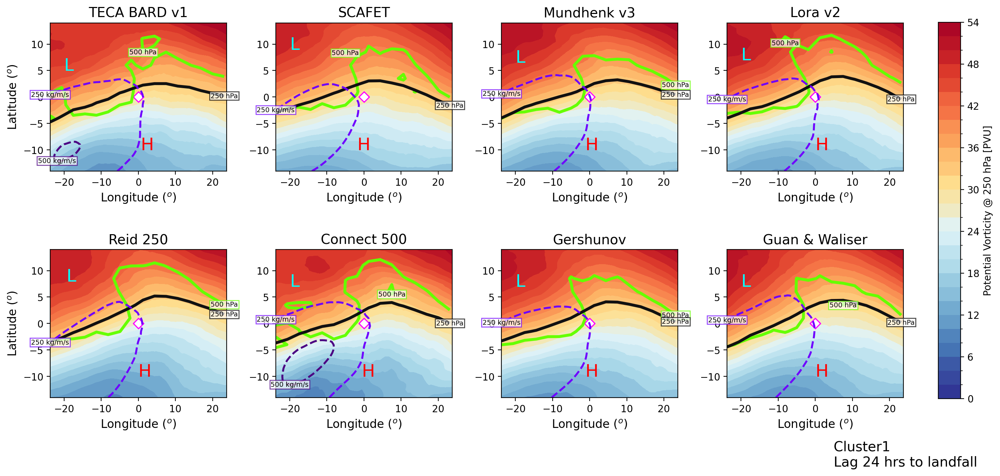

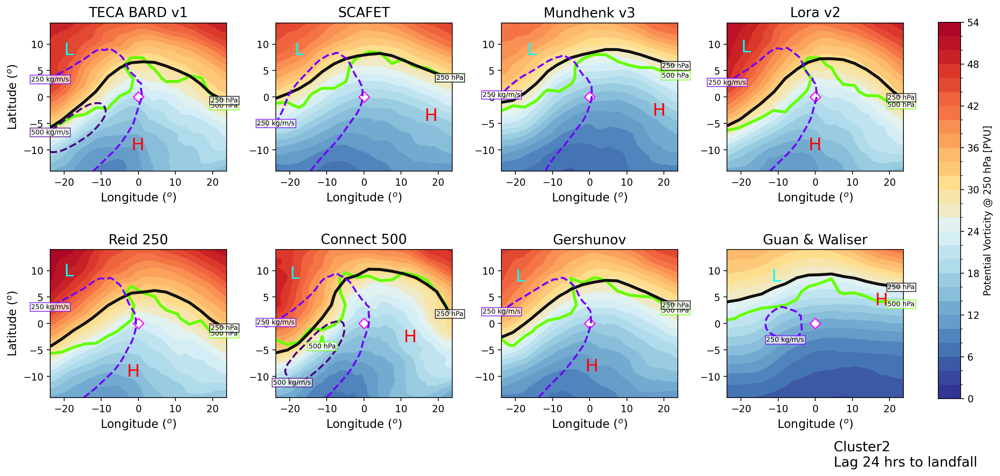

In [57]:
for lg in lags:
    
    for gr in groups:
    
        clus_2_plot = eval(f'cluster{gr+1}_len')
        fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
        plt.tight_layout(pad=12,h_pad=6,w_pad=2)

        for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
            d2plot = eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}'].sel(lev=250)/1e-7
            #d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7

            levs=np.arange(0,56,2)  # Adjust the number of levels as needed
            #norm = plt.Normalize(levels.min(), levels.max())

            plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)

            
            ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
            msl_data = eval(f'{alg}_merra')[f'slplg_{lg}_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
            mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
            xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

            _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
            if _x >= msl_data.lat.max().values - 0.5:
                _x = _x -2
            if _y >= msl_data.lat.max().values - 0.5:
                _y = _y - 2
            ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

            _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
            if _x >= msl_data.lon.max().values-0.5:
                _x = _x - 4
            if _y >= msl_data.lat.max().values-0.5:
                _y = _y - 1

            ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

            if ix%4 ==0:
                ax.set_ylabel('Latitude ($^o$)', fontsize=12)

            else:
                ax.set_ylabel('')
            ax.set_xlabel('Longitude ($^o$)', fontsize=12)

            ##############################################################################################################################
            #######################################  make contour plots for wave propagation at different levels  ########################################
            ##############################################################################################################################
            #EPV @ 500 hPa
            #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
            c1 = ax.contour(eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 hPa',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

            #EPV @ 250 hPa
            c1 = ax.contour(eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 hPa',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

            try:
                #IVT CONTOUR 250kg/m/s
                d2plot = eval(f'{alg}_merra')[f'ivtlg_{lg}_{clust[0]}']['IVT']
                c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='#6F00FF', linestyles='dashed',linewidths=2)
                x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
                ax.text(x,y, '250 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='#6F00FF', alpha=0.7,pad=1))
                #IVT CONTOUR 500kg/m/s
                c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='#4B0082', linestyles='dashed',linewidths=2)
                x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
                ax.text(x,y, '500 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='#4B0082', alpha=0.7,pad=1))
            except:
                pass

            ax.set_title(f'{alg_names[ix]}',fontsize=14)
            ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
            ax.scatter(0,0,color='white', marker='D', s=30)
        
        cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
        cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity @ 250 hPa [PVU]')
        ax.text(5, -27, f'Cluster{gr+1} \nLag {str(lg).zfill(2)} hrs to landfall', fontsize=14,fontname='sans-serif')# fontname='sans-serif')
        
        plt.savefig(f'laggedimages/{str(lg).zfill(2)}hrs_{gr}_upper.png', dpi=300)


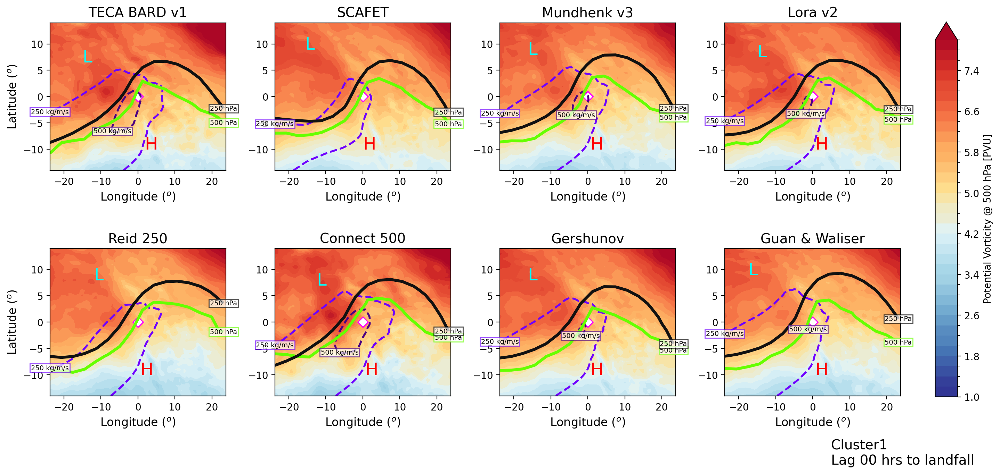

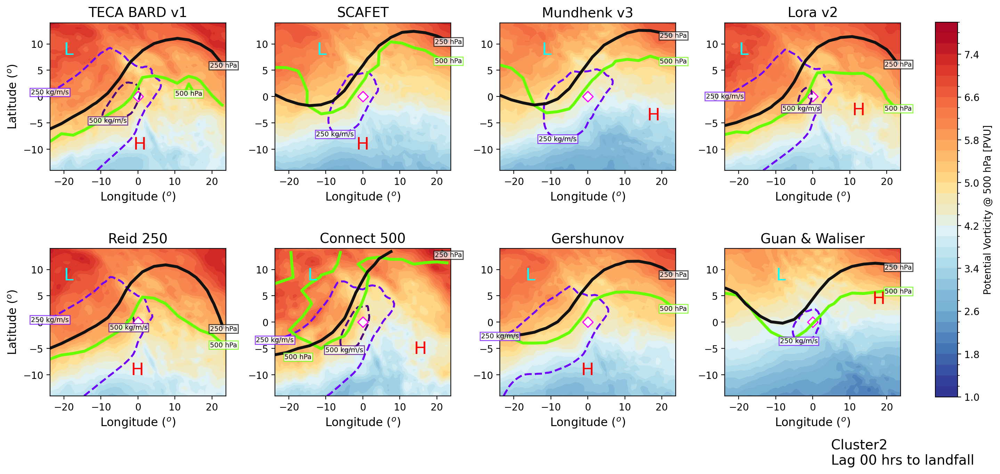

In [58]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        
        d2plot = eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}'].sel(lev=500)/1e-7
        #d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7

        levs=np.arange(1,8.1,0.2)  # Adjust the number of levels as needed
        #norm = plt.Normalize(levels.min(), levels.max())

        plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)

        
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1

        ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)

        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        try:
            
            #IVT CONTOUR 250kg/m/s
            d2plot = eval(f'{alg}_merra')[f'ivt_{clust[0]}']['IVT']
            c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='#6F00FF', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#6F00FF', alpha=0.7,pad=1))
            #IVT CONTOUR 500kg/m/s
            c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='#4B0082', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#4B0082', alpha=0.7,pad=1))
        except:
            pass

        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))


        ax.set_title(f'{alg_names[ix]}',fontsize=14)
        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
        
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity @ 500 hPa [PVU]')
    ax.text(5, -27, f'Cluster{nx+1} \nLag 00 hrs to landfall', fontsize=14,fontname='sans-serif')
    
    
    plt.savefig(f'laggedimages/00hrs_{nx}.png', dpi=300)

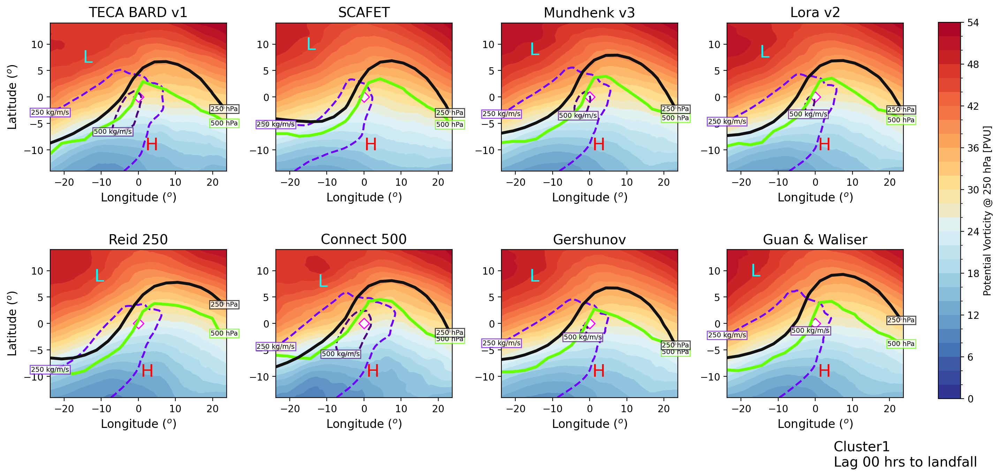

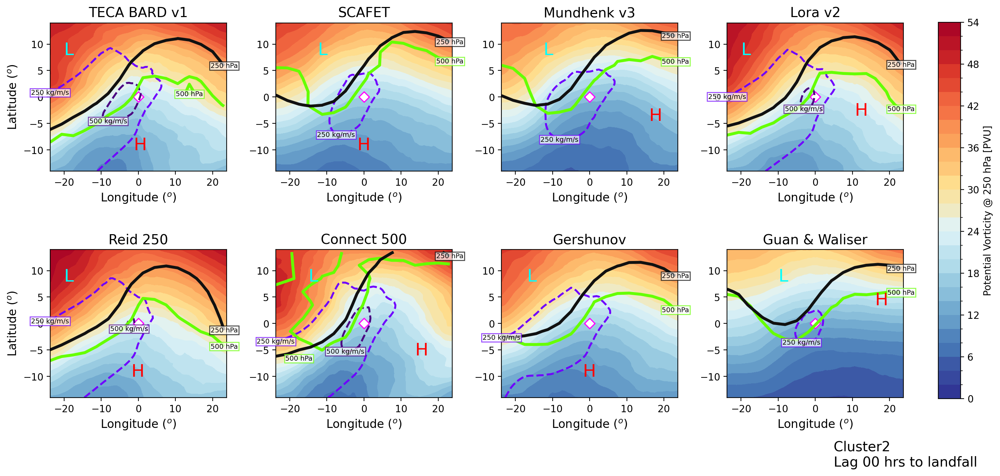

In [59]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        
        d2plot = eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}'].sel(lev=250)/1e-7
        #d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7

        levs=np.arange(0,56,2)  # Adjust the number of levels as needed
        #norm = plt.Normalize(levels.min(), levels.max())

        plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)

        
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1

        ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)

        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        try:
            
            #IVT CONTOUR 250kg/m/s
            d2plot = eval(f'{alg}_merra')[f'ivt_{clust[0]}']['IVT']
            c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='#6F00FF', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#6F00FF', alpha=0.7,pad=1))
            #IVT CONTOUR 500kg/m/s
            c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='#4B0082', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#4B0082', alpha=0.7,pad=1))
        except:
            pass

        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))


        ax.set_title(f'{alg_names[ix]}',fontsize=14)
        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
        
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity @ 250 hPa [PVU]')
    ax.text(5, -27, f'Cluster{nx+1} \nLag 00 hrs to landfall', fontsize=14,fontname='sans-serif')
    
    plt.savefig(f'laggedimages/00hrs_{nx}_upper.png', dpi=300)

In [697]:
from PIL import Image
import imageio
import os

def create_gif(image_folder,clus_num, output_gif, duration=30):
    # Get the list of image files in the folder
    #images = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith('.png') or img.endswith('.jpg')]
    
    images = glob.glob(f'{image_folder}/*_{clus_num}.png',recursive=True)
    print(images)
    # Sort the images to maintain order
    images.sort()
    images = images[::-1]
    print(images)
    
    # Create GIF using imageio
    with imageio.get_writer(f'{image_folder}/{output_gif}', mode='I', duration=duration) as writer:
        for img_path in images:
            image = Image.open(img_path)
            writer.append_data(image)




In [25]:
from moviepy.editor import ImageSequenceClip
import cv2

In [715]:
def create_gif(image_folder,clus_num, output_mp4, fps=24):
    # Get the list of image files in the folder
    #images = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith('.png') or img.endswith('.jpg')]
    
    images = glob.glob(f'{image_folder}/*_{clus_num}*r.png',recursive=True)
    print(images)
    # Sort the images to maintain order
    images.sort()
    images = images[::-1]
    print(images)
    
    # Create MP4 video using ImageSequenceClip
    clip = ImageSequenceClip(images,fps=1,durations=300)
    #clip = clip.set_loop(duration=None)  # Loop indefinitely
    clip.write_videofile(f'{image_folder}/{output_mp4}')

In [29]:
def create_mp4(image_folder,clus_num, output_mp4, fps=1):
    # Get the list of image files in the folder
    #images = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith('.png') or img.endswith('.jpg')]
    images = glob.glob(f'{image_folder}/*_{clus_num}*r.png',recursive=True)
    # Sort the images to maintain order
    images.sort()
    images = images[::-1]
    print(images)
    # Read the first image to get dimensions
    img = cv2.imread(images[0])
    height, width, _ = img.shape
    
    # Create video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Specify codec (for mp4 format)
    out = cv2.VideoWriter(output_mp4, fourcc, fps, (width, height))
    
    # Write each frame to the video
    for img_path in images:
        img = cv2.imread(img_path)
        out.write(img)
    
    # Release the video writer
    out.release()

In [31]:
if __name__ == "__main__":
    # Set the folder containing image files and output GIF file
    image_folder = 'laggedimages'
    clus_num = 0
    output_gif = f'{image_folder}/cluster{clus_num+1}_upper.mp4'
    
    # Create the GIF
    create_mp4(image_folder, clus_num, output_gif)
    print(f"Successfully created GIF: {output_gif}")

['laggedimages/24hrs_0_upper.png', 'laggedimages/18hrs_0_upper.png', 'laggedimages/12hrs_0_upper.png', 'laggedimages/06hrs_0_upper.png', 'laggedimages/04hrs_0_upper.png', 'laggedimages/02hrs_0_upper.png', 'laggedimages/00hrs_0_upper.png']
Successfully created GIF: laggedimages/cluster1_upper.mp4
